*This notebook explores the results of the "Generative Discovery" experiments with the proper parameterization.*

# Imports

## Libraries

In [1]:
import os
import numpy as np
import random

import pandas as pd
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [73]:
from orbit_generation.constants import EM_MU, family_classification
from orbit_generation.processing import reorder_orbits
from orbit_generation.propagation import jacobi_constant
from orbit_generation.visualize import plot_histogram, visualize_static_orbits
from orbit_generation.experiment import read_json_to_dataframe, generate_image_paths, concatenate_csvs_from_experiment_folder, concatenate_and_check_orbits_from_experiment_folder
from orbit_generation.latent_space import plot_combined_2d_latent_space, plot_2d_latent_space
from orbit_generation.dataset import get_first_period_dataset

## Data

In [3]:
experiments_folder = r'../../experiments'
experiments_file = r'../../experiments/experiments.json'
results_folder = r'../../experiments/results'
generated_orbits_path = os.path.join(results_folder, 'generated_orbits')
refined_orbits_path = os.path.join(results_folder, 'refined_orbits')
latent_space_with_distributions_path = os.path.join(results_folder, 'latent_space_label_distribution')
metrics_corr_matrix_path = os.path.join(results_folder, 'metrics_corr_matrix')

In [4]:
data_path = r"/orbit-generation/data/orbits_fix_1500/EM_N_fix_1500.h5"
data, orbit_df, _, _ = get_first_period_dataset(file_path=data_path)

In [5]:
df=read_json_to_dataframe(experiments_file)
df.shape

(193, 31)

In [6]:
generation_df = concatenate_csvs_from_experiment_folder(experiments_folder,'generation_df')
generation_df.shape

(55200, 10)

In [7]:
refined_orbits_df = concatenate_csvs_from_experiment_folder(experiments_folder,'refined_orbits_df')
refined_orbits_df.shape

(19954, 52)

In [8]:
refined_orbits_df.head()

,id,old_period,period,iterations_convergence,error,initial_pos_x0,initial_pos_y0,initial_pos_z0,initial_vel_x0,initial_vel_y0,initial_vel_z0,final_pos_x0,final_pos_y0,final_pos_z0,final_vel_x0,final_vel_y0,final_vel_z0,disorder_metric,correct_order,inversions,kendall_tau_distance,propagated_position_error,propagated_velocity_error,propagated_energy_error,latent_distance_to_generation,calculated_jacobi,period_distance_with_generation,feature_closest_orbit,feature_distance_from_closest_orbit,nearest_orbit,nearest_orbit_distance,distance_from_generation,centroid_distance,feature_centroid_distance,closest_family_centroid,closest_family_centroid_distance,closest_family_feature_centroid,closest_family_feature_centroid_distance,initial_conditions_distance,closest_family_full_centroid,closest_family_full_centroid_distance,family_of_feature_closest_orbit,family_of_closest_orbit,experiment_id,disorder_metric.1,correct_order.1,inversions.1,kendall_tau_distance.1,disorder_metric.2,correct_order.2,inversions.2,kendall_tau_distance.2
0,0,2.825363,3.395283,9,2.866915e-13,1.085847,0.005968,-0.006422,0.007797,0.193831,-0.008355,1.131194,-0.024008,2.689891e-16,-0.007002,0.117360,-2.899136e-15,372.0,66.0,255.0,0.103030,1.329037e-12,2.465352e-12,1.481195e-14,0.116331,3.173176,0.569921,17972,0.000104,17976,0.409855,1.208203,0.830977,3.933960,22,0.166260,6,0.645355,0.095566,6,0.121419,15.0,15.0,54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,3,6.410875,6.306637,9,3.831047e-10,1.077167,0.244604,0.427690,0.050803,-1.548356,0.846692,0.774984,0.387647,4.910636e-01,0.073323,-1.206546,8.439762e-01,150.0,69.0,98.0,0.039596,6.852558e-12,1.434101e-11,2.466171e-11,0.239348,0.591147,0.104238,30631,0.000694,27453,3.967637,4.725327,2.500625,2.045136,18,0.486709,15,0.159043,0.482846,23,0.482840,29.0,25.0,54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,5,2.774760,3.382448,8,1.560247e-13,1.078207,0.011581,0.003735,0.007048,0.144430,-0.018307,1.140318,-0.014000,-7.494117e-14,-0.005923,0.077325,1.243685e-13,276.0,64.0,187.0,0.075556,1.162738e-12,2.025713e-12,3.925031e-15,0.140431,3.179420,0.607688,17992,0.000240,17992,0.169285,1.082909,0.824064,3.947770,22,0.173278,6,0.659336,0.097635,6,0.114895,15.0,15.0,54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,11,22.927443,22.944445,9,6.897051e-12,1.048586,0.020412,-0.036356,0.013088,0.715763,-0.018567,0.906908,0.048871,-1.470502e-02,0.185644,0.562421,2.131846e-02,4.0,98.0,2.0,0.000808,7.630890e-12,1.316706e-11,2.564077e-12,0.045951,2.885993,0.017003,42943,0.003184,42922,2.087514,2.232660,1.988188,15.698535,32,0.302875,37,1.264695,0.276101,37,0.300966,40.0,40.0,54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,14,6.659652,5.645048,6,3.873477e-12,0.787035,-0.122416,0.049502,0.276159,0.940814,-0.412493,0.642761,-0.185012,1.920668e-02,0.314235,0.605758,-3.829873e-01,68.0,78.0,36.0,0.014545,1.742954e-12,3.321685e-12,1.132078e-12,0.263792,2.810963,1.014603,28414,0.000941,28420,0.970354,2.066139,0.323756,1.658958,19,0.222946,14,0.327624,0.374478,24,0.221195,26.0,26.0,54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


# Processing

In [9]:
# Add the parameters as columns
parameters_df = df['parameters'].apply(pd.Series)
df = pd.concat([df, parameters_df], axis=1)
df = df.drop(columns=['parameters'])

# Extract only the 'beta' parameter from model_kwargs
beta_values = df['model_kwargs'].apply(lambda x: x.get('beta'))
df['beta'] = beta_values
df = df.drop(columns=['model_kwargs'])

In [10]:
# KL-loss was being multiplied by beta, so a few adjustments are needed
df['train_kl_loss'] = df['train_kl_loss'] / df['beta']
df['val_kl_loss'] = df['val_kl_loss'] / df['beta']

## Filtering

In [11]:
# Take just the experiments of Generative Discovery
df = df[(df['id'] >= 1) & (df['id'] <= 140)]
generation_df['experiment_id'] = generation_df['experiment_id'].astype(int)
generation_df = generation_df[(generation_df['experiment_id'] >= 1) & (generation_df['experiment_id'] <= 140)]
refined_orbits_df['experiment_id'] = refined_orbits_df['experiment_id'].astype(int)
refined_orbits_df = refined_orbits_df[(refined_orbits_df['experiment_id'] >= 1) & (refined_orbits_df['experiment_id'] <= 140)]
refined_orbits_df.shape

(15419, 52)

In [12]:
len(refined_orbits_df['experiment_id'].value_counts())

140

As can be seen afterwards, experiments with beta=10 tend to mode collpase that's why we filter them

In [13]:
filter_beta_10=False

In [14]:
init_df=df

In [15]:
if filter_beta_10:
    rows_to_remove = df[df['beta'] == float(10)]
    distinct_ids = rows_to_remove['id'].unique()
    distinct_ids = [int(x) for x in distinct_ids]
    print(df.shape)
    df = df[df['beta'] != float(10)]
    print(df.shape)
    
    print("Before filtering:", generation_df.shape)
    generation_df = generation_df[~generation_df['experiment_id'].isin(distinct_ids)]
    print("After filtering:", generation_df.shape)

    print(refined_orbits_df.shape)
    refined_orbits_df = refined_orbits_df[~refined_orbits_df['experiment_id'].isin(distinct_ids)]
    print(refined_orbits_df.shape)

In [16]:
# Add refined Orbits to experiment df
experiment_id_counts = refined_orbits_df['experiment_id'].value_counts()
experiment_id_counts.index = experiment_id_counts.index.astype(df['id'].dtype)

df = df.merge(experiment_id_counts.rename('count_refined_orbits'), 
              left_on='id', 
              right_index=True, 
              how='left')

df['count_refined_orbits'] = df['count_refined_orbits'].fillna(0).astype(int)

In [17]:
static_parameters = ['id_experiment', 'seq_len','feature_dim', 'val_split', 'batch_size', 'lr', 'epochs', 'input_seq_len_convergence', 'samples_to_generate', 'max_iter_convergence']
repeated_metrics = ['family_ari', 'family_nmi', 'family_homogeneity', 'family_completeness', 'family_fmi', 'family_purity', 'family_silhouette_score', 'family_jaccard', 'inversions', 'kendall_tau_distance']
df = df.drop(columns=static_parameters + repeated_metrics)

# Discovery
by Distance

In [18]:
refined_orbits_df = refined_orbits_df.merge(df[['id', 'discarded_family_ids']], 
                                            how='left', 
                                            left_on='experiment_id', 
                                            right_on='id')

In [19]:
refined_orbits_df.head()

,id_x,old_period,period,iterations_convergence,error,initial_pos_x0,initial_pos_y0,initial_pos_z0,initial_vel_x0,initial_vel_y0,initial_vel_z0,final_pos_x0,final_pos_y0,final_pos_z0,final_vel_x0,final_vel_y0,final_vel_z0,disorder_metric,correct_order,inversions,kendall_tau_distance,propagated_position_error,propagated_velocity_error,propagated_energy_error,latent_distance_to_generation,calculated_jacobi,period_distance_with_generation,feature_closest_orbit,feature_distance_from_closest_orbit,nearest_orbit,nearest_orbit_distance,distance_from_generation,centroid_distance,feature_centroid_distance,closest_family_centroid,closest_family_centroid_distance,closest_family_feature_centroid,closest_family_feature_centroid_distance,initial_conditions_distance,closest_family_full_centroid,closest_family_full_centroid_distance,family_of_feature_closest_orbit,family_of_closest_orbit,experiment_id,disorder_metric.1,correct_order.1,inversions.1,kendall_tau_distance.1,disorder_metric.2,correct_order.2,inversions.2,kendall_tau_distance.2,id_y,discarded_family_ids
0,0,2.825363,3.395283,9,2.866915e-13,1.085847,0.005968,-0.006422,0.007797,0.193831,-0.008355,1.131194,-0.024008,2.689891e-16,-0.007002,0.117360,-2.899136e-15,372.0,66.0,255.0,0.103030,1.329037e-12,2.465352e-12,1.481195e-14,0.116331,3.173176,0.569921,17972,0.000104,17976,0.409855,1.208203,0.830977,3.933960,22,0.166260,6,0.645355,0.095566,6,0.121419,15.0,15.0,54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54,"[7.0, 6.0, 10.0, 11.0, 20.0]"
1,3,6.410875,6.306637,9,3.831047e-10,1.077167,0.244604,0.427690,0.050803,-1.548356,0.846692,0.774984,0.387647,4.910636e-01,0.073323,-1.206546,8.439762e-01,150.0,69.0,98.0,0.039596,6.852558e-12,1.434101e-11,2.466171e-11,0.239348,0.591147,0.104238,30631,0.000694,27453,3.967637,4.725327,2.500625,2.045136,18,0.486709,15,0.159043,0.482846,23,0.482840,29.0,25.0,54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54,"[7.0, 6.0, 10.0, 11.0, 20.0]"
2,5,2.774760,3.382448,8,1.560247e-13,1.078207,0.011581,0.003735,0.007048,0.144430,-0.018307,1.140318,-0.014000,-7.494117e-14,-0.005923,0.077325,1.243685e-13,276.0,64.0,187.0,0.075556,1.162738e-12,2.025713e-12,3.925031e-15,0.140431,3.179420,0.607688,17992,0.000240,17992,0.169285,1.082909,0.824064,3.947770,22,0.173278,6,0.659336,0.097635,6,0.114895,15.0,15.0,54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54,"[7.0, 6.0, 10.0, 11.0, 20.0]"
3,11,22.927443,22.944445,9,6.897051e-12,1.048586,0.020412,-0.036356,0.013088,0.715763,-0.018567,0.906908,0.048871,-1.470502e-02,0.185644,0.562421,2.131846e-02,4.0,98.0,2.0,0.000808,7.630890e-12,1.316706e-11,2.564077e-12,0.045951,2.885993,0.017003,42943,0.003184,42922,2.087514,2.232660,1.988188,15.698535,32,0.302875,37,1.264695,0.276101,37,0.300966,40.0,40.0,54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54,"[7.0, 6.0, 10.0, 11.0, 20.0]"
4,14,6.659652,5.645048,6,3.873477e-12,0.787035,-0.122416,0.049502,0.276159,0.940814,-0.412493,0.642761,-0.185012,1.920668e-02,0.314235,0.605758,-3.829873e-01,68.0,78.0,36.0,0.014545,1.742954e-12,3.321685e-12,1.132078e-12,0.263792,2.810963,1.014603,28414,0.000941,28420,0.970354,2.066139,0.323756,1.658958,19,0.222946,14,0.327624,0.374478,24,0.221195,26.0,26.0,54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54,"[7.0, 6.0, 10.0, 11.0, 20.0]"


In [20]:
def check_discovered(row):
    """
    Checks if a family is discovered based on feature distance or physical distance.

    Args:
        row (pd.Series): A row of the DataFrame containing the required columns.

    Returns:
        str: 'no', 'yes_by_feature_distance', or 'yes_by_physical_distance'.
    """
    discarded_ids = row['discarded_family_ids']
    
    if row['family_of_feature_closest_orbit'] in discarded_ids:
        return 'yes_by_feature_distance'
    elif row['family_of_closest_orbit'] in discarded_ids:
        return 'yes_by_physical_distance'
    else:
        return 'no'

# Apply the function to create a new column
refined_orbits_df['is_discovered'] = refined_orbits_df.apply(check_discovered, axis=1)

In [21]:
# Filter the DataFrame for is_discovered = True
discovery_df = refined_orbits_df[refined_orbits_df['is_discovered'] != 'no']

# Count distinct values in both columns
family_of_feature_closest_orbit_unique = discovery_df['family_of_feature_closest_orbit'].nunique()
family_of_closest_orbit_unique = discovery_df['family_of_closest_orbit'].nunique()

# Results
print(f"Distinct values in family_of_feature_closest_orbit: {family_of_feature_closest_orbit_unique}")
print(f"Distinct values in family_of_closest_orbit: {family_of_closest_orbit_unique}")

Distinct values in family_of_feature_closest_orbit: 39
Distinct values in family_of_closest_orbit: 36


Check Discovery Table is correct:

In [22]:
discovery_df[['family_of_feature_closest_orbit','family_of_closest_orbit', 'discarded_family_ids']].tail()

,family_of_feature_closest_orbit,family_of_closest_orbit,discarded_family_ids
15383,4.0,6.0,"[19.0, 22.0, 6.0, 4.0, 34.0]"
15412,42.0,34.0,"[19.0, 22.0, 6.0, 4.0, 34.0]"
15413,34.0,34.0,"[19.0, 22.0, 6.0, 4.0, 34.0]"
15414,34.0,34.0,"[19.0, 22.0, 6.0, 4.0, 34.0]"
15418,40.0,34.0,"[19.0, 22.0, 6.0, 4.0, 34.0]"


In [23]:
discovery_df.head()

,id_x,old_period,period,iterations_convergence,error,initial_pos_x0,initial_pos_y0,initial_pos_z0,initial_vel_x0,initial_vel_y0,initial_vel_z0,final_pos_x0,final_pos_y0,final_pos_z0,final_vel_x0,final_vel_y0,final_vel_z0,disorder_metric,correct_order,inversions,kendall_tau_distance,propagated_position_error,propagated_velocity_error,propagated_energy_error,latent_distance_to_generation,calculated_jacobi,period_distance_with_generation,feature_closest_orbit,feature_distance_from_closest_orbit,nearest_orbit,nearest_orbit_distance,distance_from_generation,centroid_distance,feature_centroid_distance,closest_family_centroid,closest_family_centroid_distance,closest_family_feature_centroid,closest_family_feature_centroid_distance,initial_conditions_distance,closest_family_full_centroid,closest_family_full_centroid_distance,family_of_feature_closest_orbit,family_of_closest_orbit,experiment_id,disorder_metric.1,correct_order.1,inversions.1,kendall_tau_distance.1,disorder_metric.2,correct_order.2,inversions.2,kendall_tau_distance.2,id_y,discarded_family_ids,is_discovered
9,21,4.109756,3.772282,11,5.809167e-10,-0.492125,0.017246,0.879876,0.044311,1.155262,0.058201,-1.305611,-0.148333,3.786156e-12,-0.247352,2.178455,-3.109613e-11,546.0,58.0,363.0,0.146667,1.039431e-11,1.529578e-11,8.716139e-11,1.916160,-1.540141,0.337474,8364,1.863932,22356,14.585988,17.799465,1.352006,5.260581,14,0.793401,26,3.123184,1.612060,19,0.614075,8.0,20.0,54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54,"[7.0, 6.0, 10.0, 11.0, 20.0]",yes_by_physical_distance
41,105,3.786636,2.695289,8,4.236947e-12,0.901330,0.027432,0.031192,-0.054651,0.094691,0.007353,0.835528,-0.013808,-3.159178e-13,-0.009413,0.014662,9.915588e-13,782.0,68.0,540.0,0.218182,1.157259e-12,2.640594e-12,3.033264e-14,0.135950,3.199292,1.091347,11652,0.000043,11679,0.279380,1.331631,0.969881,4.626887,22,0.025567,27,0.021343,0.124534,27,0.026574,10.0,10.0,54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54,"[7.0, 6.0, 10.0, 11.0, 20.0]",yes_by_feature_distance
43,110,5.809158,2.906221,10,1.646301e-10,0.763687,0.108018,0.001552,-0.004107,0.325480,0.014488,0.831495,0.086320,-1.181488e-14,0.077371,0.146500,-2.768109e-14,518.0,63.0,341.0,0.137778,1.625316e-12,6.635515e-12,2.152151e-12,0.668609,3.149150,2.902937,11511,0.000887,11540,1.099301,2.544065,0.943858,4.410495,22,0.051885,27,0.204942,0.209651,27,0.052892,10.0,10.0,54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54,"[7.0, 6.0, 10.0, 11.0, 20.0]",yes_by_feature_distance
44,111,3.620637,2.960255,8,3.314262e-10,0.732160,0.038682,0.011956,-0.009810,0.477991,-0.004243,0.811601,-0.017497,5.036500e-14,-0.017670,0.258789,2.833329e-13,296.0,63.0,195.0,0.078788,2.090426e-12,1.005065e-11,3.576775e-12,0.107120,3.138802,0.660381,11496,0.000411,11511,0.846723,1.856263,0.890234,4.355490,22,0.106171,27,0.259924,0.240290,27,0.107178,10.0,10.0,54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54,"[7.0, 6.0, 10.0, 11.0, 20.0]",yes_by_feature_distance
47,114,6.198089,3.173515,10,4.280202e-12,-0.384599,0.032056,0.016298,-0.070312,3.027065,0.028812,-0.828224,0.608296,-1.896491e-15,1.191312,1.560566,-1.250985e-14,264.0,64.0,167.0,0.067475,7.291419e-13,4.948208e-12,2.897974e-13,0.702469,-0.832852,3.024574,8364,1.041229,22485,12.339714,11.756360,1.299619,5.207866,4,0.643684,7,2.886682,2.066945,4,0.640804,8.0,20.0,54,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,54,"[7.0, 6.0, 10.0, 11.0, 20.0]",yes_by_physical_distance


Experiments with more families discovered

In [24]:
distinct_counts = discovery_df.groupby('experiment_id')['family_of_closest_orbit'].nunique().sort_values(ascending=False)
print(distinct_counts)

experiment_id
107    16
109    14
85     14
92     14
114    14
100    13
137    13
136    13
71     12
132    12
127    12
123    12
134    12
135    11
139    11
120    11
104    11
115    10
78     10
99     10
101    10
93     10
86     10
129    10
124     9
106     9
80      9
117     9
116     9
67      9
138     9
126     9
79      9
57      9
64      9
65      9
97      8
52      8
58      8
121     8
113     8
131     8
128     8
81      8
108     8
102     8
96      7
94      7
68      7
29      7
72      7
74      7
122     7
82      7
110     7
63      6
44      6
88      6
91      6
83      6
87      6
130     6
118     6
112     6
111     6
95      6
103     6
76      6
73      6
43      5
59      5
47      5
60      5
39      5
41      5
37      5
36      5
119     5
125     5
90      5
89      5
46      5
61      4
70      4
69      4
66      4
31      4
133     4
98      4
140     4
51      4
45      4
62      3
30      3
77      3
105     3
33      3
32      2
40    

In [25]:
sorted_ids = distinct_counts.index
sorted_df = df.set_index('id').loc[sorted_ids].reset_index()
sorted_df.head()

,experiment_id,discarded_family_ids,discarded_families,val_total_loss,val_reconstruction_loss,val_kl_loss,train_total_loss,train_reconstruction_loss,train_kl_loss,family_v-measure,family_accuracy,position_error,velocity_error,energy_error,disorder_metric,correct_order,regression_jacobi_r2,regression_period_r2,regression_stability_r2,data_used,families_to_discard,model_name,latent_dim,distance_metric,beta,count_refined_orbits
0,107,"[37.0, 26.0, 30.0, 10.0, 36.0, 5.0, 21.0, 24.0...","[S_R23, S_L5_A, S_LPOE, S_L1_L, S_R21, S_DRO, ...",2.086706,0.765441,6.606330,2.463329,0.992290,7.355188,0.85483,0.749857,0.161440,0.339817,1.741626,258.906667,66.736667,0.214653,0.830198,0.078059,EM_N_fix_1500,20,inception_time_wp_vae,6,euclidean,0.200,129
1,109,"[11.0, 18.0, 30.0, 17.0, 24.0, 35.0, 3.0, 12.0...","[S_L1_V, S_L3_HN, S_LPOE, S_L3_A, S_L4_SP, S_R...",6.583935,1.517367,5.066568,6.788245,1.751801,5.036442,0.868537,0.782733,0.096514,0.273590,2.817960,162.726667,70.490000,0.639710,0.711977,0.145525,EM_N_fix_1500,20,inception_time_wp_vae,6,euclidean,1.000,164
2,85,"[38.0, 7.0, 11.0, 8.0, 19.0, 4.0, 25.0, 13.0, ...","[S_R31, S_L1_A, S_L1_V, S_L1_HN, S_L3_HS, S_DP...",2.393264,2.358850,34.414206,2.074154,2.037747,36.407851,0.738964,0.54319,0.247000,0.435030,1.121503,391.880000,70.416667,0.160402,0.704023,0.081999,EM_N_fix_1500,20,vae_conv5_legit,2,euclidean,0.001,126
3,92,"[1.0, 9.0, 39.0, 22.0, 35.0, 8.0, 30.0, 32.0, ...","[S_BN, S_L1_HS, S_R32, S_L4_A, S_R14, S_L1_HN,...",0.327536,0.309597,17.939543,0.496893,0.476555,20.337773,0.798784,0.629027,0.182796,0.336668,1.447032,281.106667,76.776667,0.347808,0.676703,0.120085,EM_N_fix_1500,20,vae_conv5_legit,6,euclidean,0.001,93
4,114,"[28.0, 42.0, 9.0, 33.0, 17.0, 38.0, 16.0, 30.0...","[S_L5_SP, S_R43, S_L1_HS, S_R12, S_L3_A, S_R31...",1.791177,0.762435,5.143707,2.090796,1.007295,5.417504,0.849191,0.742792,0.271843,0.364542,0.457431,269.853333,73.763333,0.215633,0.627119,0.018027,EM_N_fix_1500,30,vae_conv5_legit,2,euclidean,0.200,146


In [26]:
count_physical_distance = refined_orbits_df['is_discovered'].value_counts().get('yes_by_physical_distance', 0)
count_feature_distance = refined_orbits_df['is_discovered'].value_counts().get('yes_by_feature_distance', 0)
print(f"{len(discovery_df)} orbits, out of the {len(refined_orbits_df)} refined ones, were closer to an orbit that was not included in the training:")
print(f"- {count_physical_distance} by physical distance, in which you can find {family_of_feature_closest_orbit_unique} families out of the total 42")
print(f"- {count_feature_distance} by feature distance, in which you can find {family_of_closest_orbit_unique} families out of the total 42")

2984 orbits, out of the 15419 refined ones, were closer to an orbit that was not included in the training:
- 388 by physical distance, in which you can find 39 families out of the total 42
- 2596 by feature distance, in which you can find 36 families out of the total 42


In [27]:
print(f"How many of the {len(refined_orbits_df)} physical orbits that were generated could be part of families we yet don't know?")

How many of the 15419 physical orbits that were generated could be part of families we yet don't know?


Some of them are really far away from the orbits from the dataset:
- In physical space:

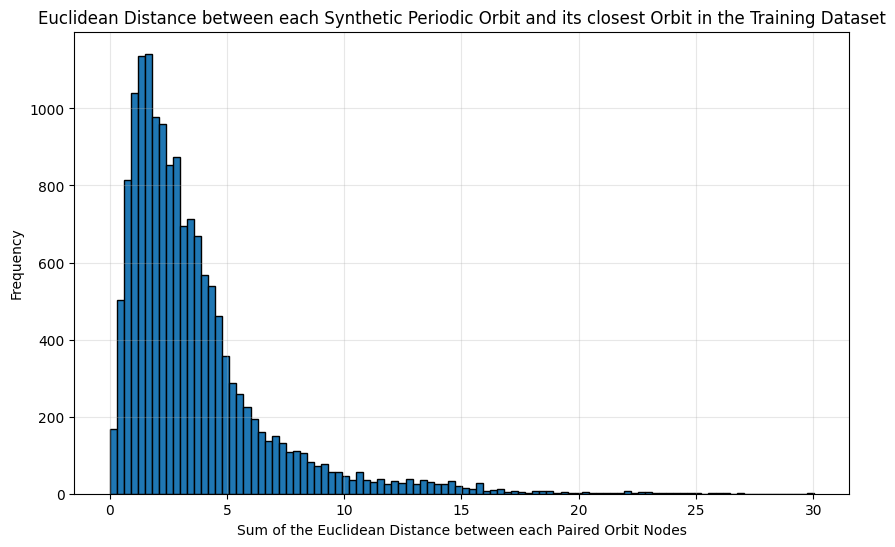

In [28]:
plot_histogram(refined_orbits_df['nearest_orbit_distance'], bins=100, title='Euclidean Distance between each Synthetic Periodic Orbit and its closest Orbit in the Training Dataset', xlabel='Sum of the Euclidean Distance between each Paired Orbit Nodes')

- In feature space:

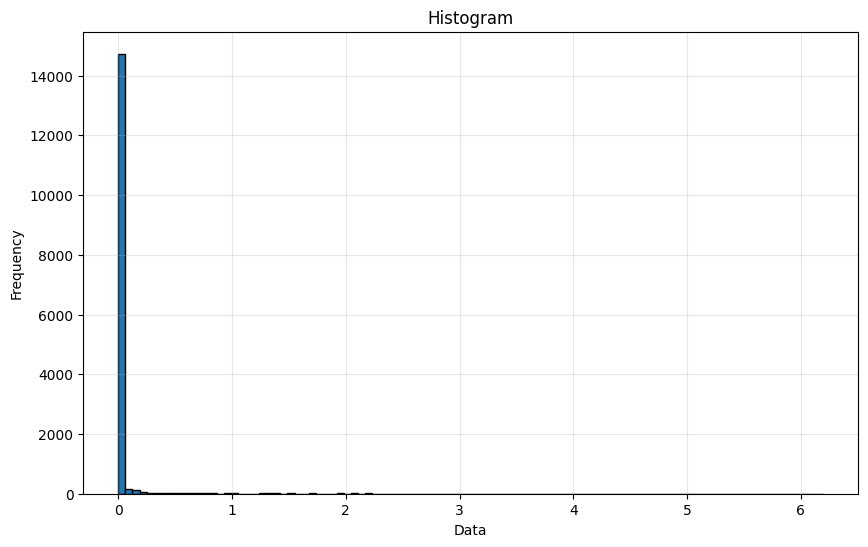

In [29]:
plot_histogram(refined_orbits_df['feature_distance_from_closest_orbit'], bins=100)

In [30]:
results = np.array([jacobi_constant(np.transpose(data[:,1:,:],(0,2,1))[i][0], EM_MU)[0] for i in range(orbit_df.shape[0])])
orbit_df['calculated_jacobi'] = results

features_used = ['period', 'calculated_jacobi']

dataset_features = orbit_df[features_used].values
refined_orbits_features = refined_orbits_df[features_used].values

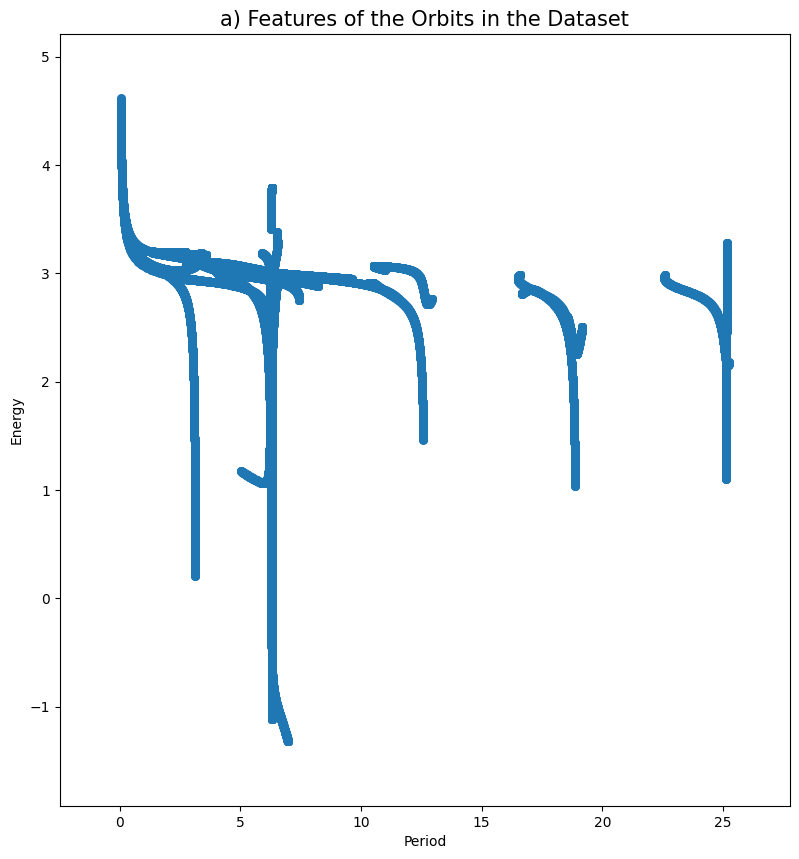

In [31]:
plot_2d_latent_space(dataset_features,
                     np.zeros(len(dataset_features)),
                     show_legend=False,
                     title='a) Features of the Orbits in the Dataset',
                     normalize_data=False,
                     figsize=(13,13.83),
                     axis_labels=('Period', 'Energy'),
                     title_size=15)

In [90]:
family_of_closest_orbit = refined_orbits_df['family_of_closest_orbit'].values
refinement_distance_from_generation = refined_orbits_df['distance_from_generation'].values
rf_predictions = np.load('rf_predictions.npy')

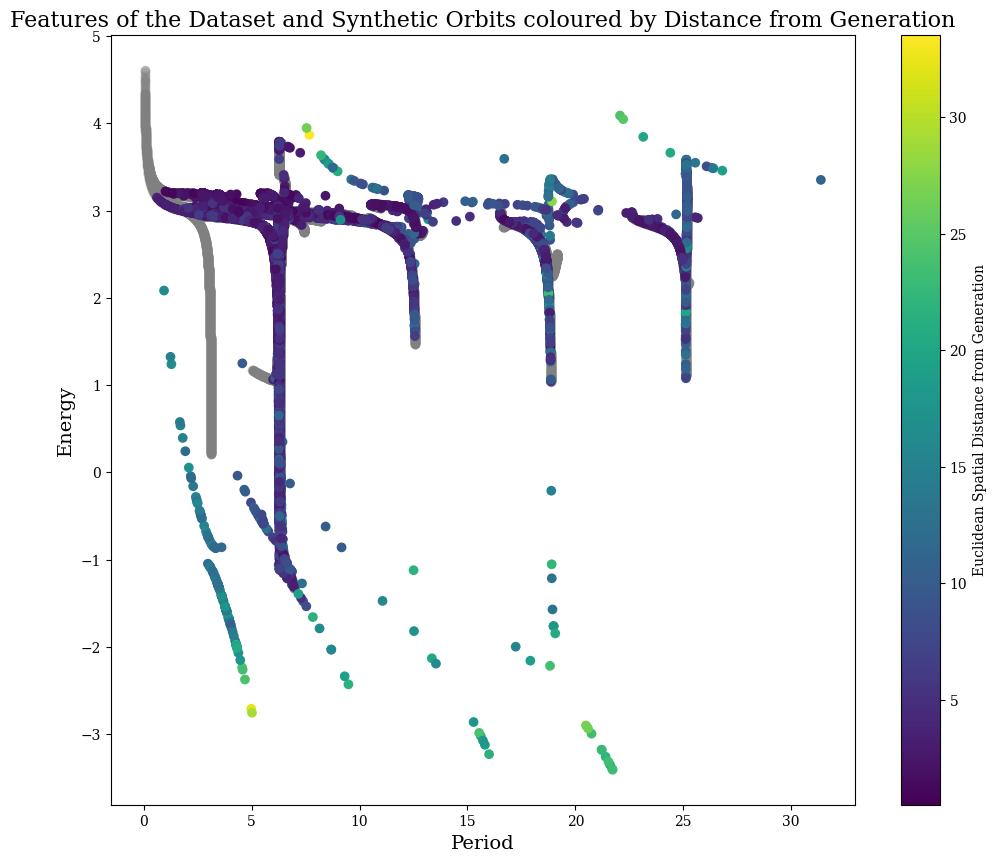

In [88]:
plot_combined_2d_latent_space(real_latent=dataset_features,
                              synthetic_latent=refined_orbits_features,
                              synthetic_labels=refinement_distance_from_generation,
                              colormap='viridis',
                              axis_labels=('Period', 'Energy'),
                              figsize=(12,10),
                              title='Features of the Dataset and Synthetic Orbits coloured by Distance from Generation',
                              feature_title='Euclidean Spatial Distance from Generation'
                              
                              )

In [76]:
family_dict = dict(zip(family_classification["Id"], family_classification["Label"]))

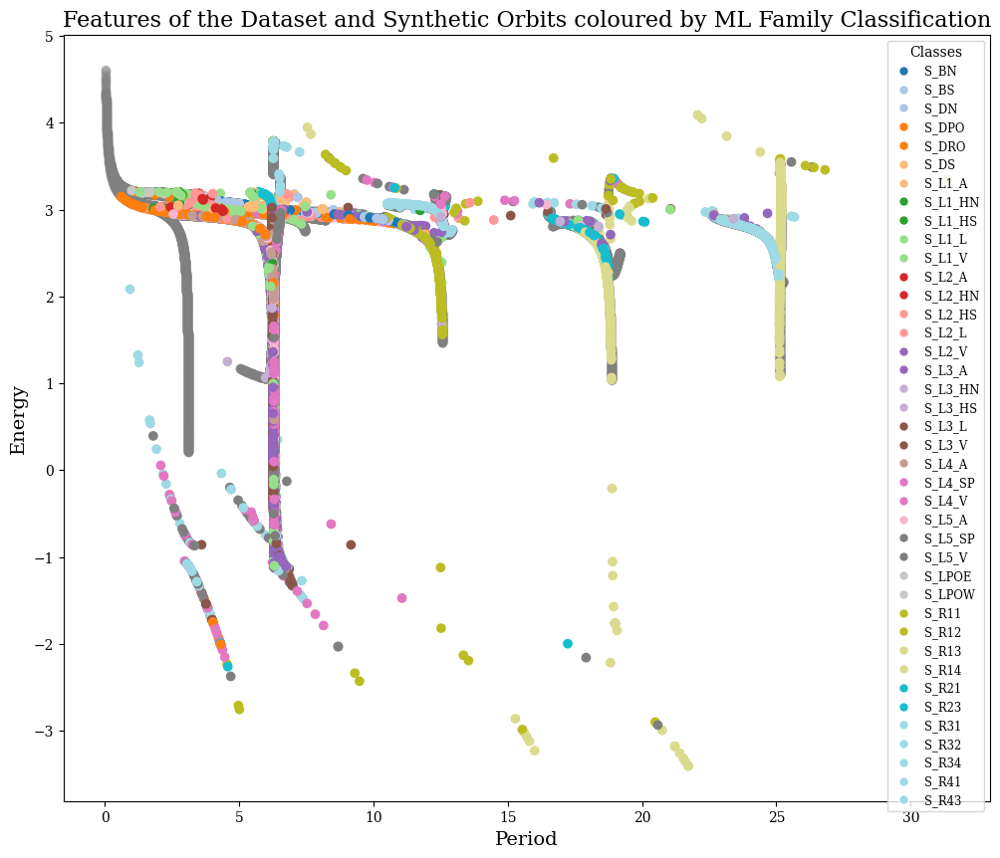

In [93]:
plot_combined_2d_latent_space(real_latent=dataset_features,
                              synthetic_latent=refined_orbits_features,
                              synthetic_labels=rf_predictions,
                              label_names=family_dict,
                              colormap='plasma',
                              axis_labels=('Period', 'Energy'),
                              figsize=(12,10),
                              title='Features of the Dataset and Synthetic Orbits coloured by ML Family Classification',
                              feature_title='Euclidean Spatial Distance from Generation'
                              )

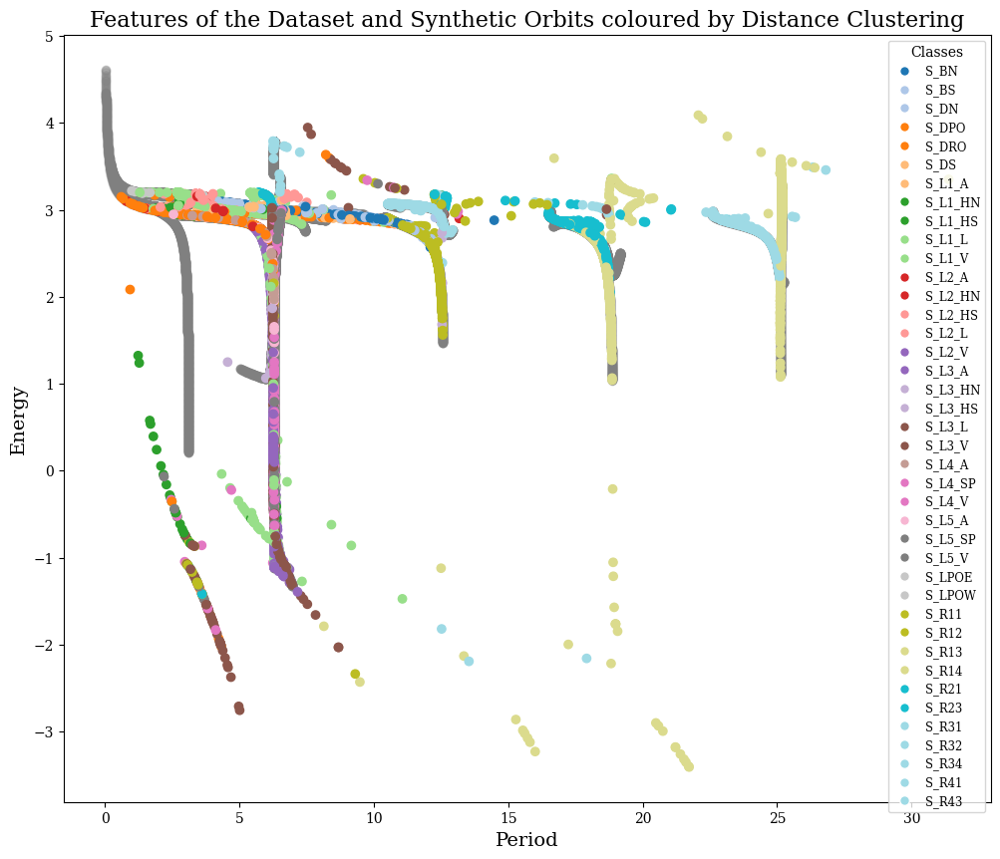

In [94]:
plot_combined_2d_latent_space(real_latent=dataset_features,
                              synthetic_latent=refined_orbits_features,
                              synthetic_labels=family_of_closest_orbit,
                              label_names=family_dict,
                              colormap='plasma',
                              axis_labels=('Period', 'Energy'),
                              figsize=(12,10),
                              title='Features of the Dataset and Synthetic Orbits coloured by Distance Clustering',
                              feature_title='Euclidean Spatial Distance from Generation'
                              )

## Histograms

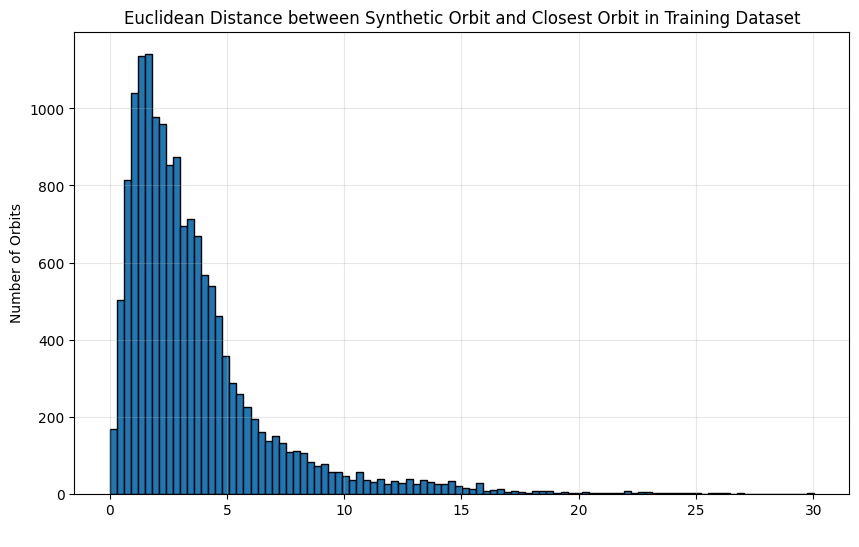

In [35]:
plot_histogram(refined_orbits_df['nearest_orbit_distance'], bins=100, title="Euclidean Distance between Synthetic Orbit and Closest Orbit in Training Dataset", ylabel='Number of Orbits', xlabel=' ')

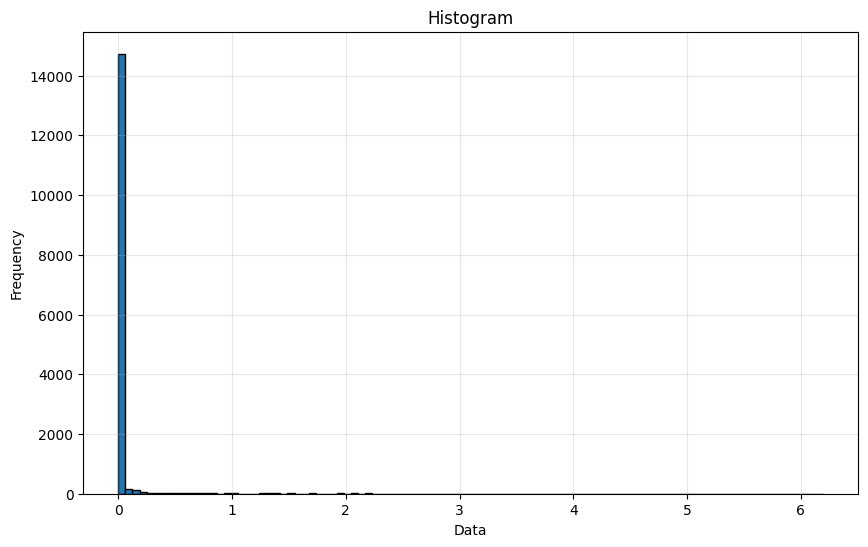

In [36]:
plot_histogram(refined_orbits_df['feature_distance_from_closest_orbit'], bins=100)

# Orbit Visualization

In [37]:
def filter_and_find_position(df, row_indexes, experiment_id_column):
    # Ensure row_indexes is a list
    if not isinstance(row_indexes, list):
        row_indexes = [row_indexes]
    
    positions = []
    experiment_ids = []
    
    for row_index in row_indexes:
        # Get the experiment_id value from the given row using iloc
        experiment_id = df.iloc[row_index][experiment_id_column]
        
        # Filter the DataFrame for rows with the same experiment_id
        filtered_df = df[df[experiment_id_column] == experiment_id]
        
        # Sort the filtered_df by 'id'
        sorted_df = filtered_df.sort_values(by='id_x')
        
        # Find the position of the initial row in the sorted DataFrame
        position = sorted_df.index.get_loc(df.index[row_index])
        
        positions.append(position)
        experiment_ids.append(int(experiment_id))
    
    return positions, experiment_ids

In [38]:
def find_closest_rows(df, column, value, n):
    # Calculate the absolute difference between the column values and the given value
    df['diff'] = (df[column] - value).abs()
    
    # Sort the DataFrame by the difference
    sorted_df = df.sort_values(by='diff')
    
    # Get the indexes of the n closest rows
    closest_indexes = sorted_df.head(n).index.tolist()
    
    # Drop the temporary 'diff' column
    df.drop(columns=['diff'], inplace=True)
    
    return closest_indexes

In [39]:
def visualize_orbit_and_closest_by_distance(df, column, value, n, experiment_id_column, orbits_folder, orbit_dataset):
    specific_orbits = []
    df.reset_index(drop=True, inplace=True)
    closest_rows = find_closest_rows(df, column, value, n)
    closest_indexes = df.loc[closest_rows].index.tolist()
    positions, experiment_ids = filter_and_find_position(df, closest_indexes, experiment_id_column)
    nearest_orbits = df.loc[closest_rows]['nearest_orbit'].tolist()
    
    for pos, exp_id, nearest_orbit in zip(positions, experiment_ids, nearest_orbits):
        orbits = np.load(f'{orbits_folder}/experiment_{exp_id}/exp{exp_id}_refined_orbits.npy')
        specific_orbit = orbits[pos:pos+1]
        specific_orbit, _, _ = reorder_orbits(specific_orbit)
        nearest_orbit_data = orbit_dataset[nearest_orbit:nearest_orbit+1]
        combined_orbits = np.vstack([specific_orbit, nearest_orbit_data])
        specific_orbits.append(combined_orbits)
    
    for orbits in specific_orbits:
        visualize_static_orbits(orbits[:,1:,:], orbit_names=['Synthetic Orbit', 'Closest Orbit in Training Dataset'],title=f'Physical Orbit Distance: {value}', equal_aspect=True)

    return specific_orbits

## Specific Distances

### Spatial

1

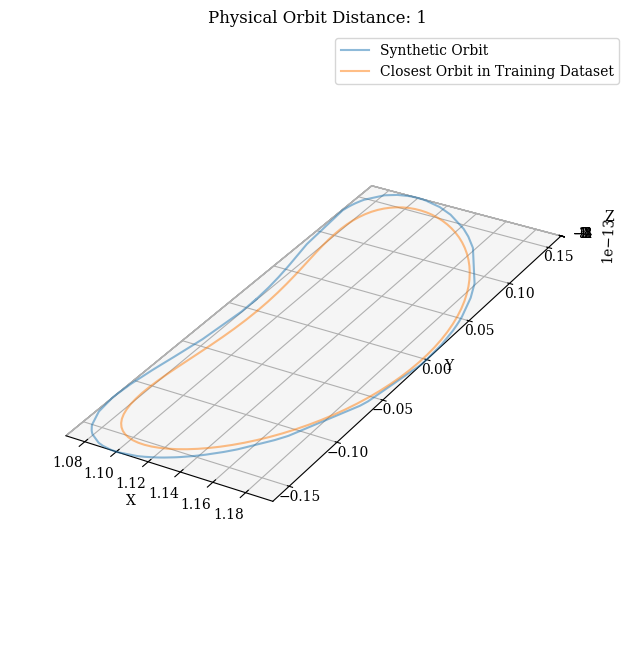

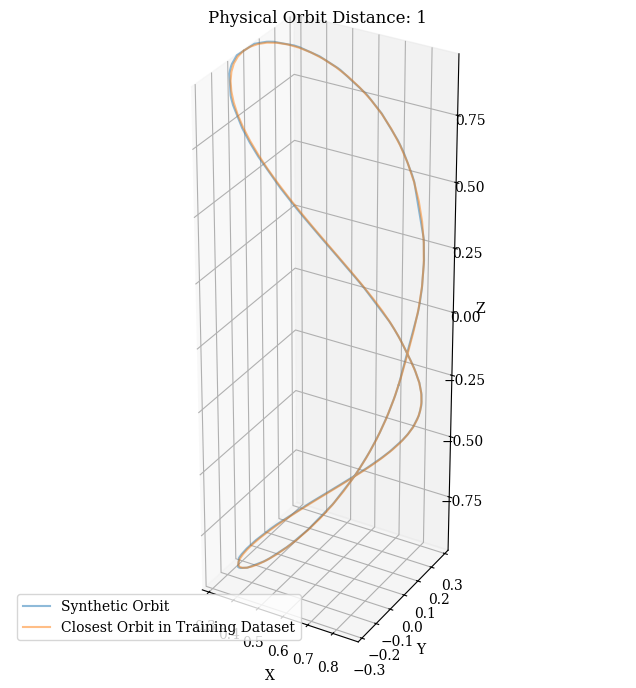

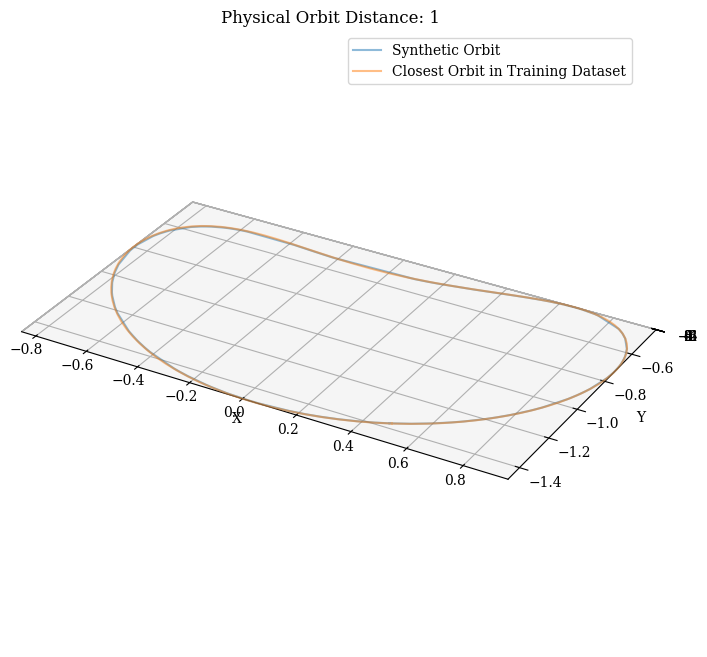

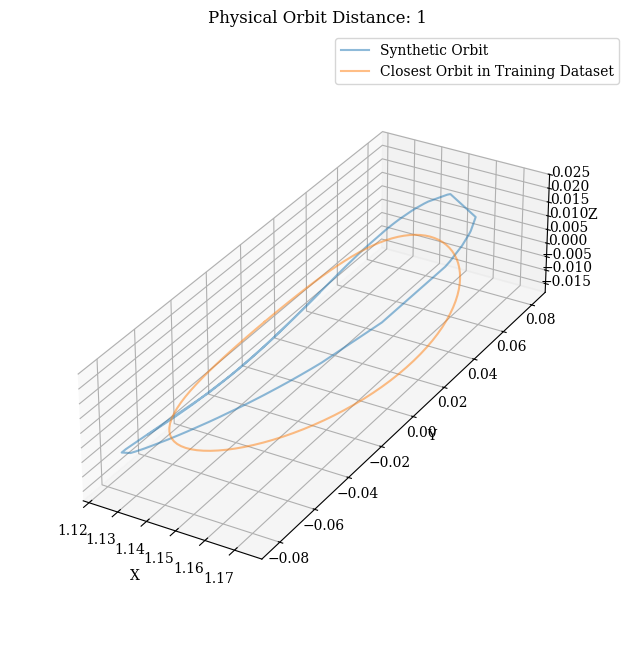

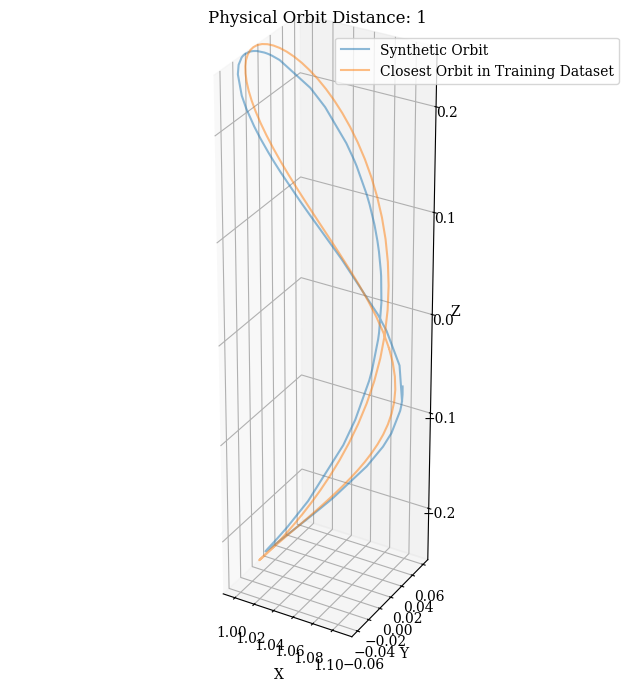

In [40]:
specific_orbits = visualize_orbit_and_closest_by_distance(refined_orbits_df, 'nearest_orbit_distance', 1, 5, 'experiment_id', experiments_folder, data)

2.5

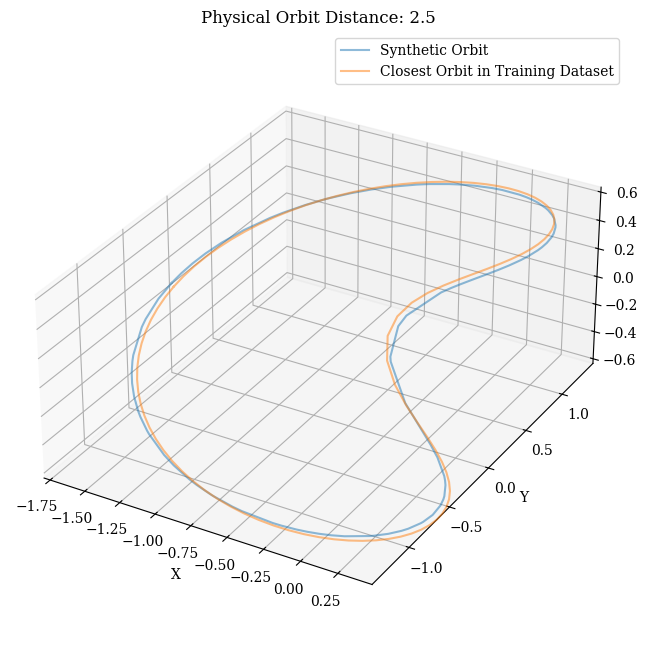

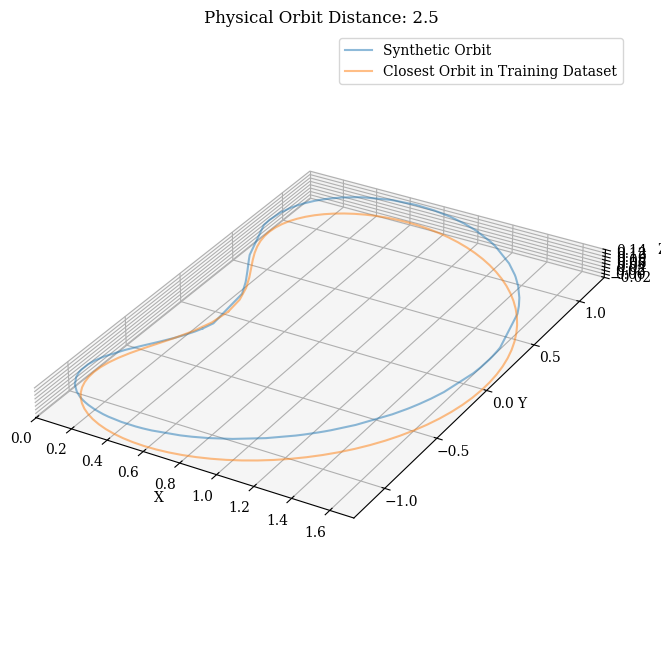

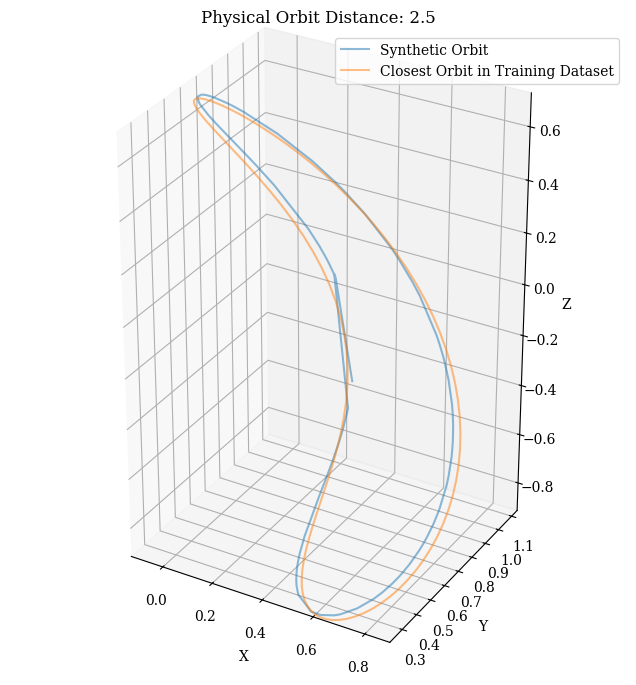

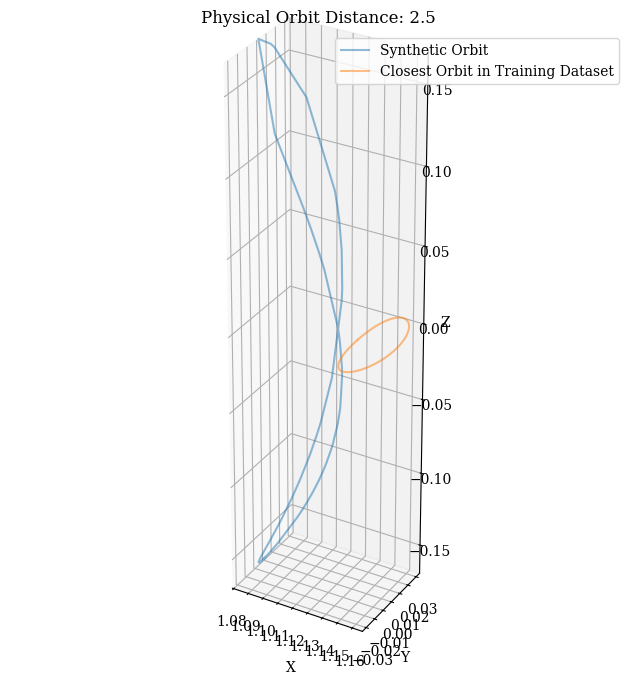

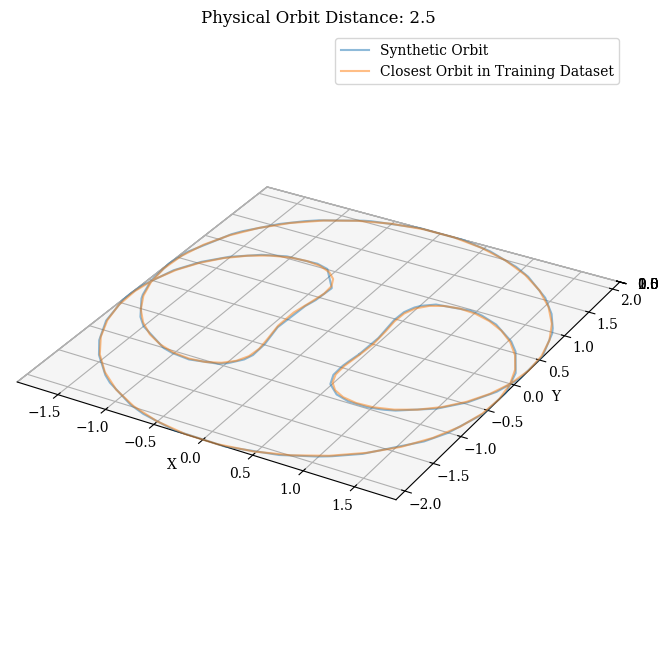

In [41]:
specific_orbits = visualize_orbit_and_closest_by_distance(refined_orbits_df, 'nearest_orbit_distance', 2.5, 5, 'experiment_id', experiments_folder, data)

5

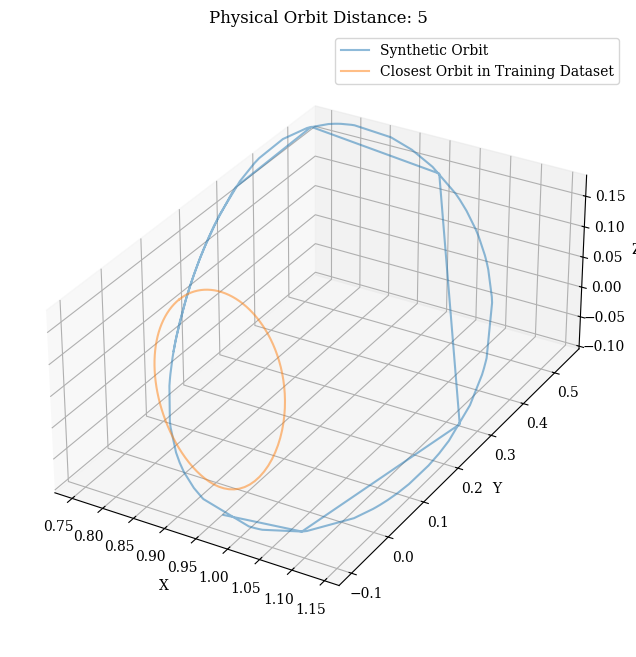

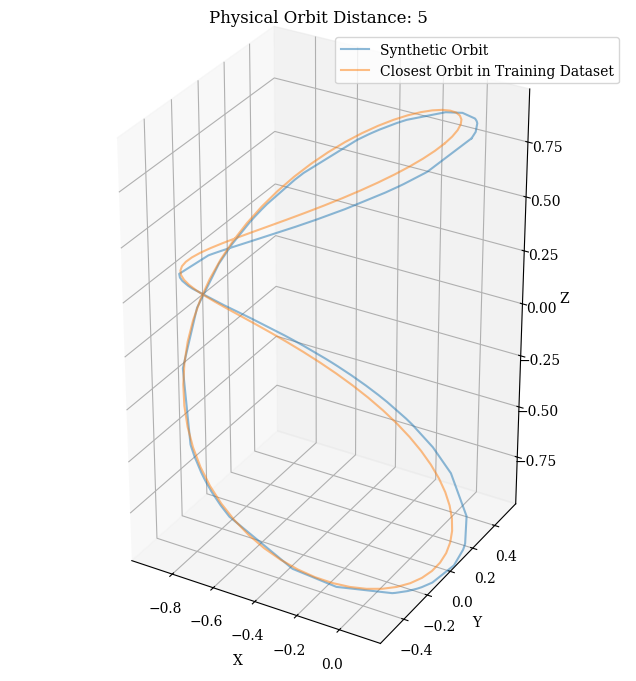

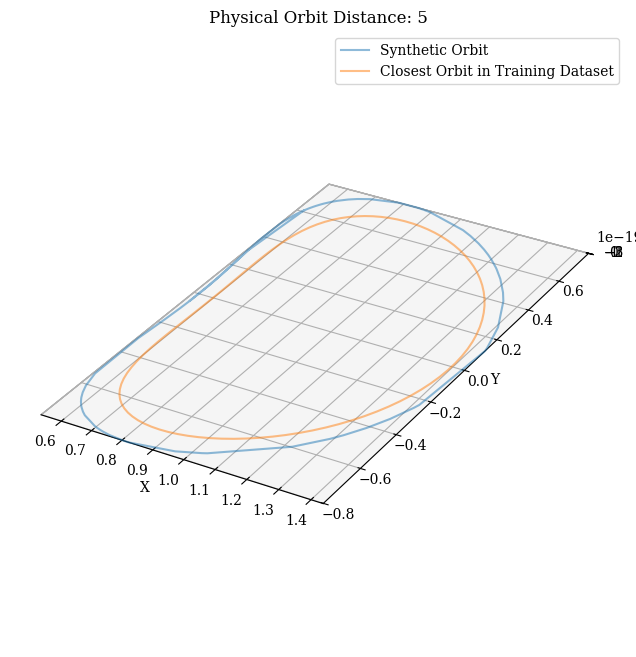

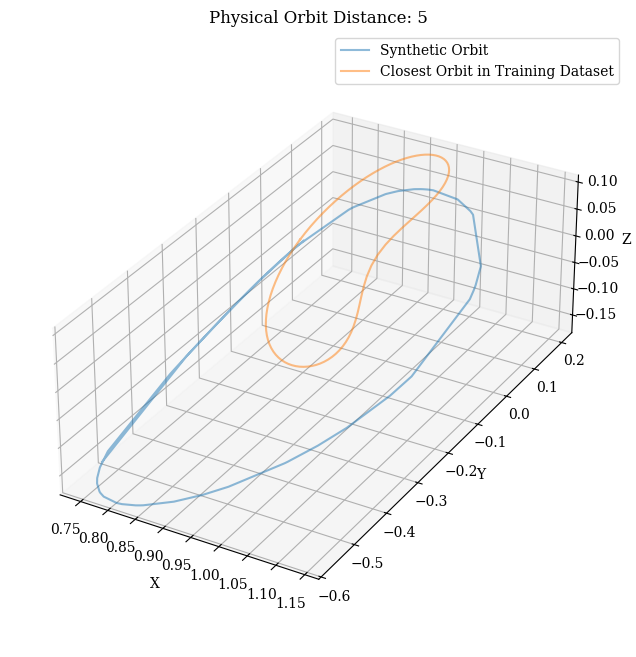

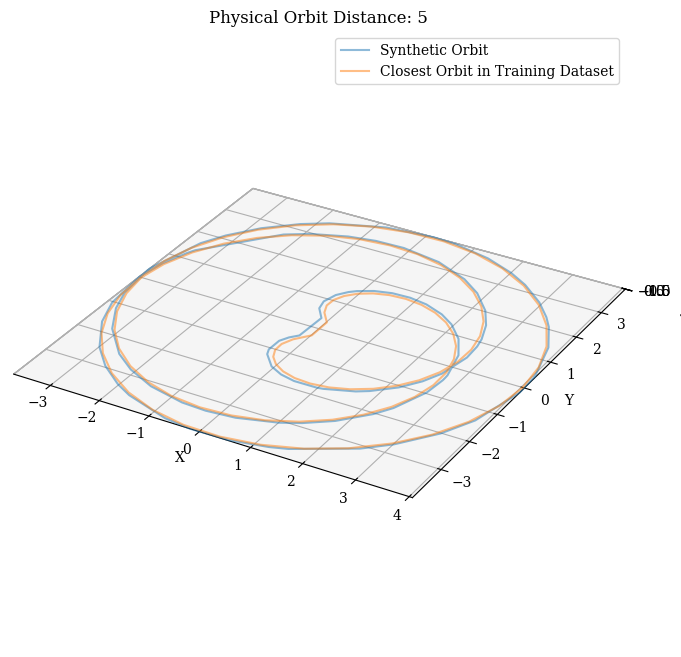

In [42]:
specific_orbits = visualize_orbit_and_closest_by_distance(refined_orbits_df, 'nearest_orbit_distance', 5, 5, 'experiment_id', experiments_folder, data)

10

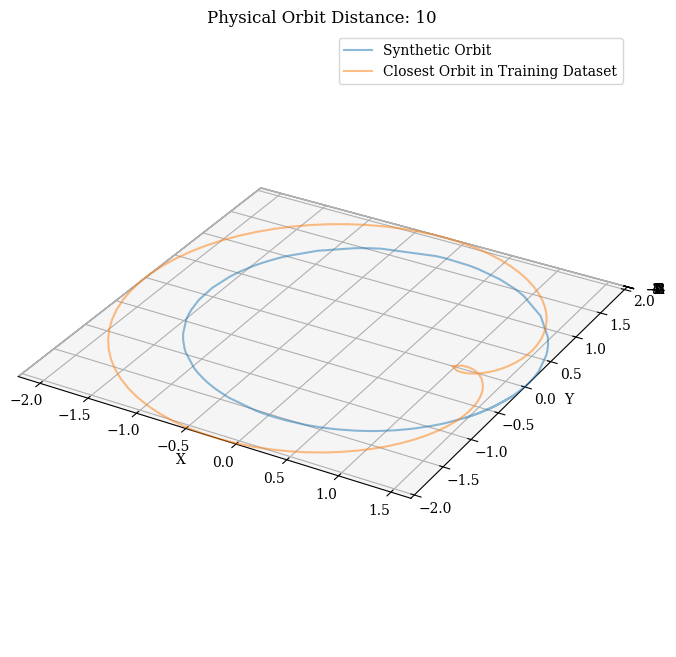

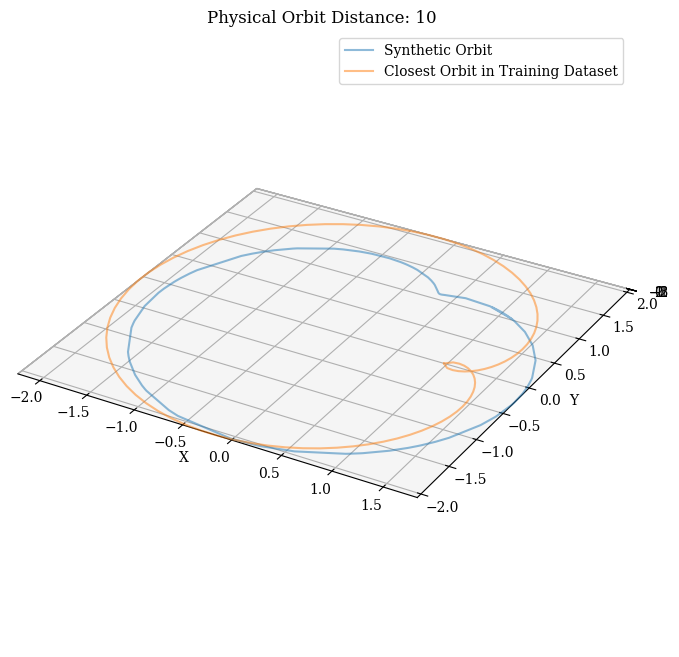

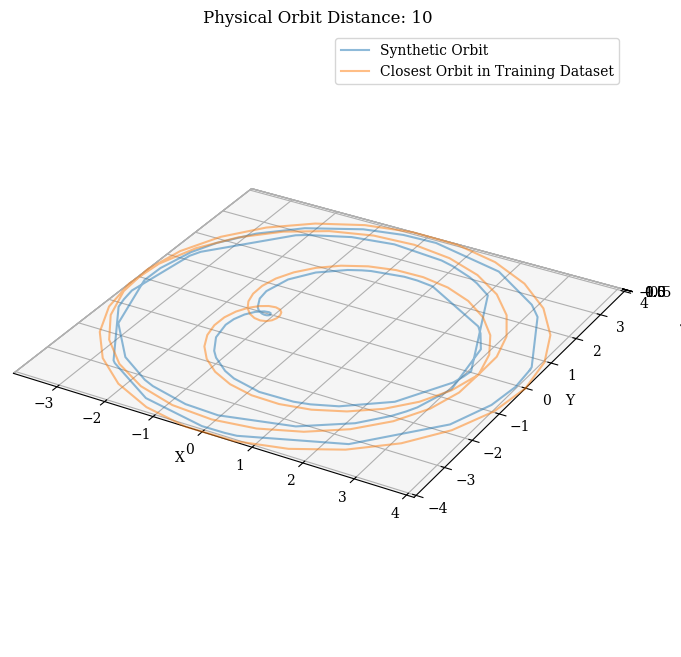

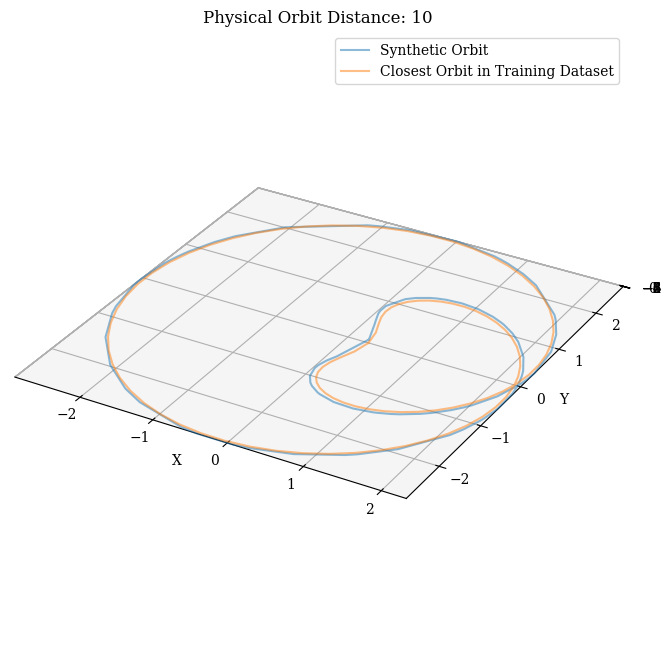

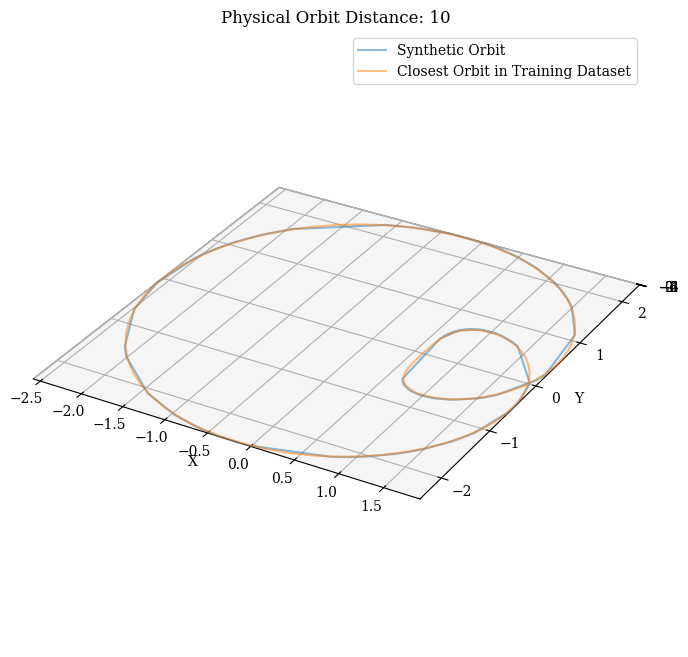

In [43]:
specific_orbits = visualize_orbit_and_closest_by_distance(refined_orbits_df, 'nearest_orbit_distance', 10, 5, 'experiment_id', experiments_folder, data)

20

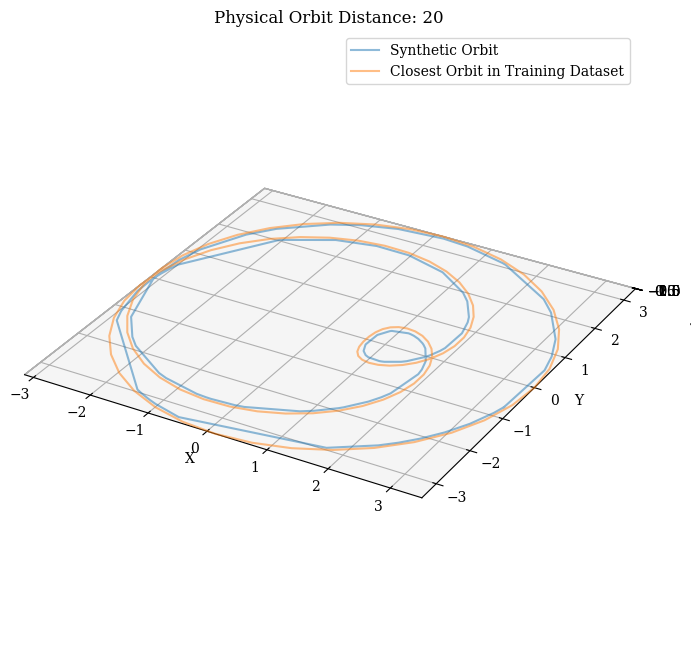

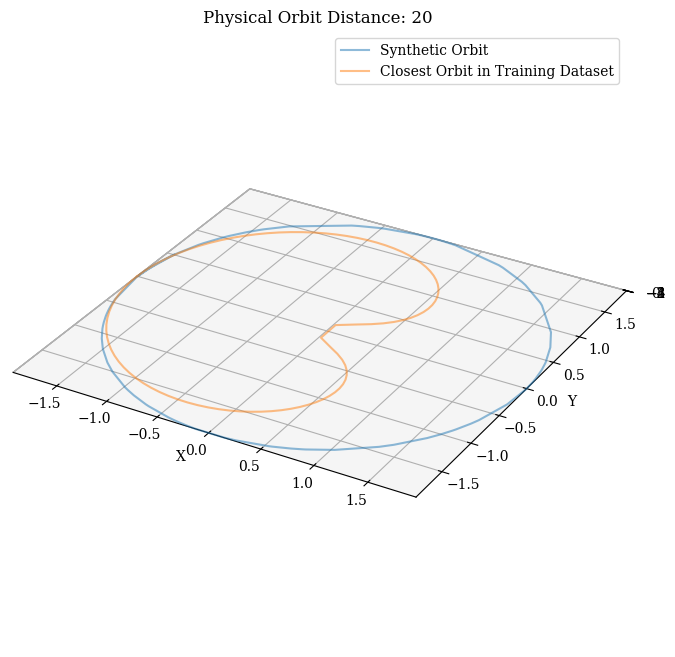

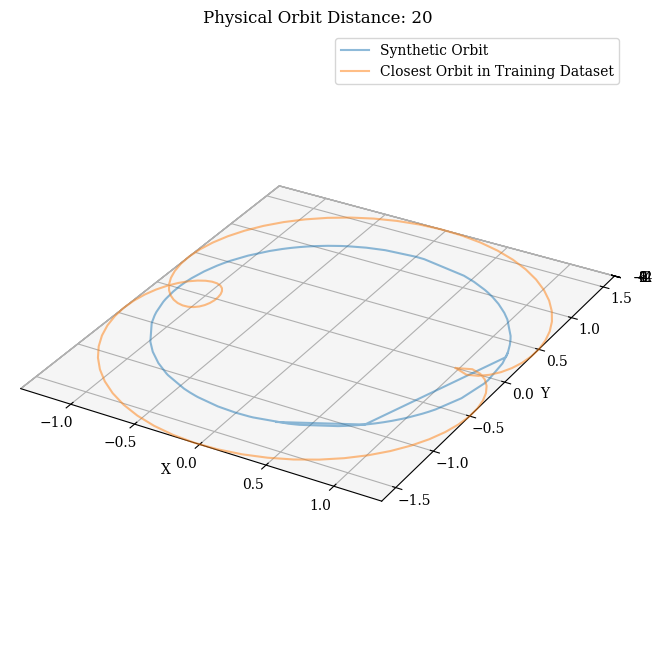

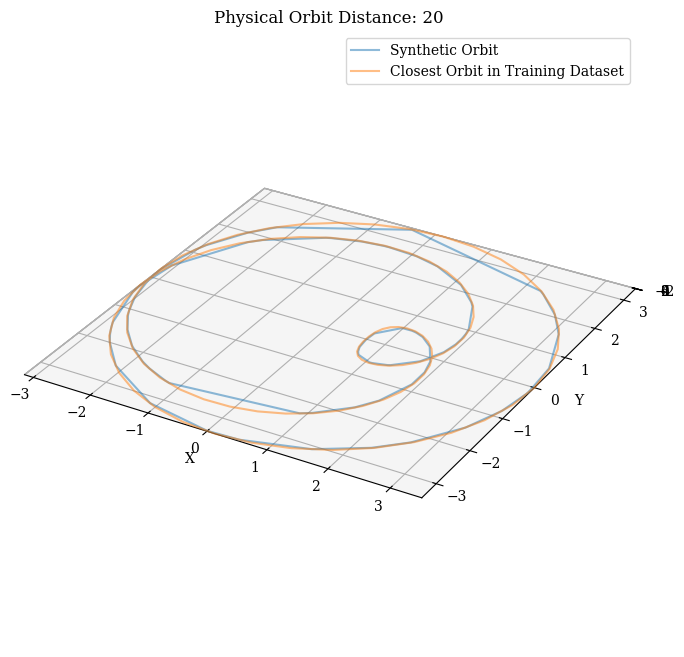

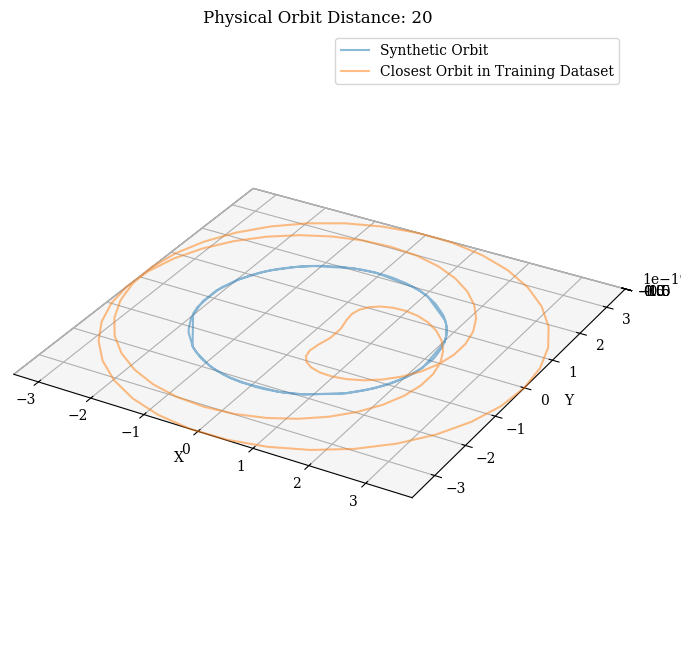

In [44]:
specific_orbits = visualize_orbit_and_closest_by_distance(refined_orbits_df, 'nearest_orbit_distance', 20, 5, 'experiment_id', experiments_folder, data)

30

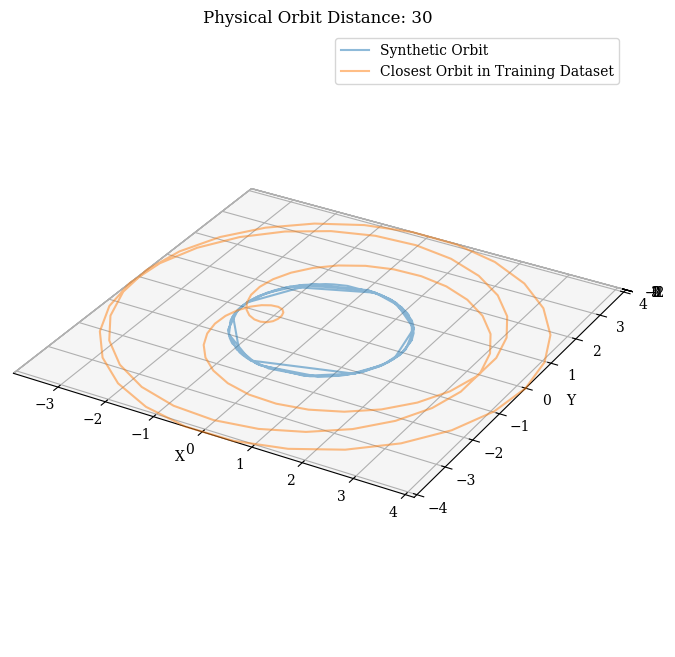

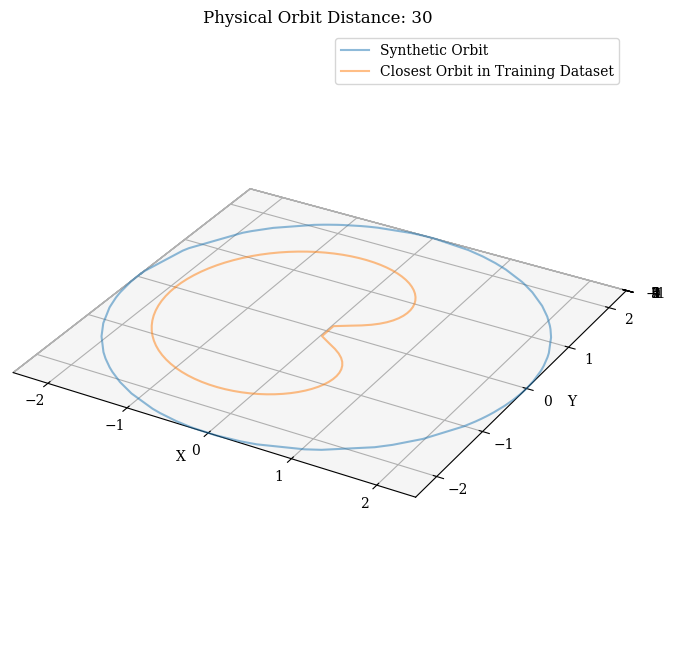

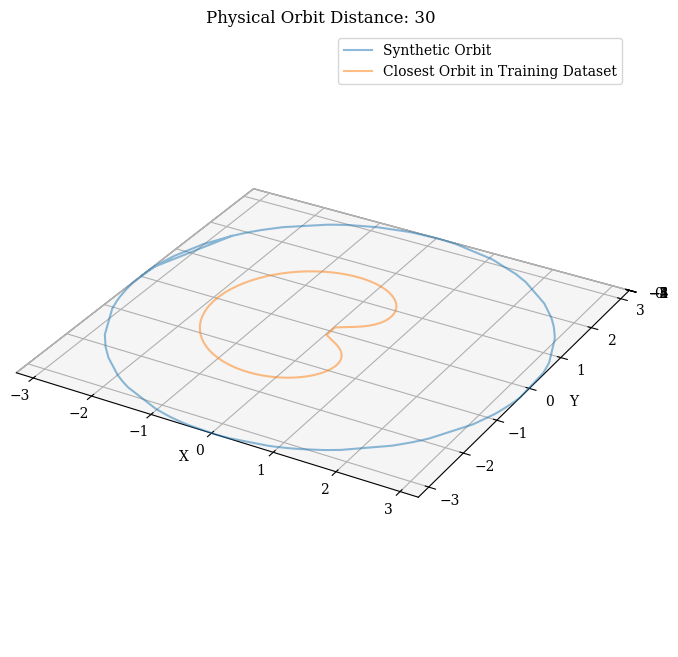

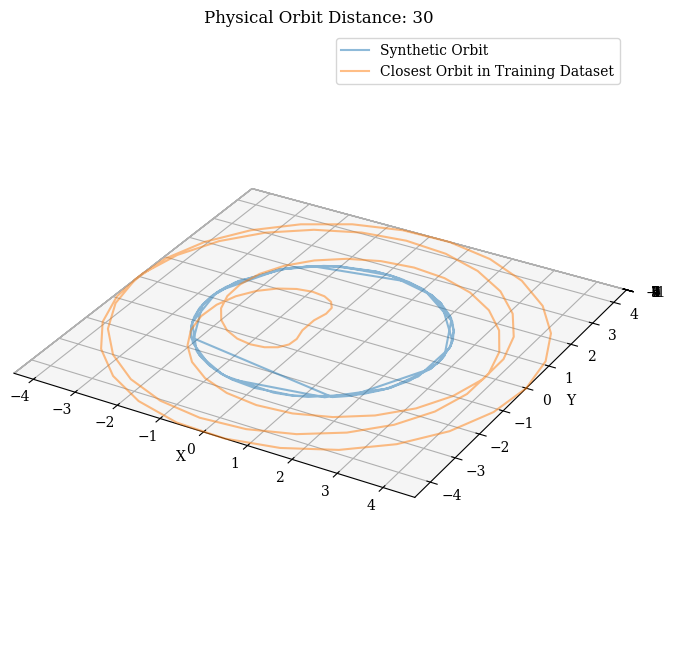

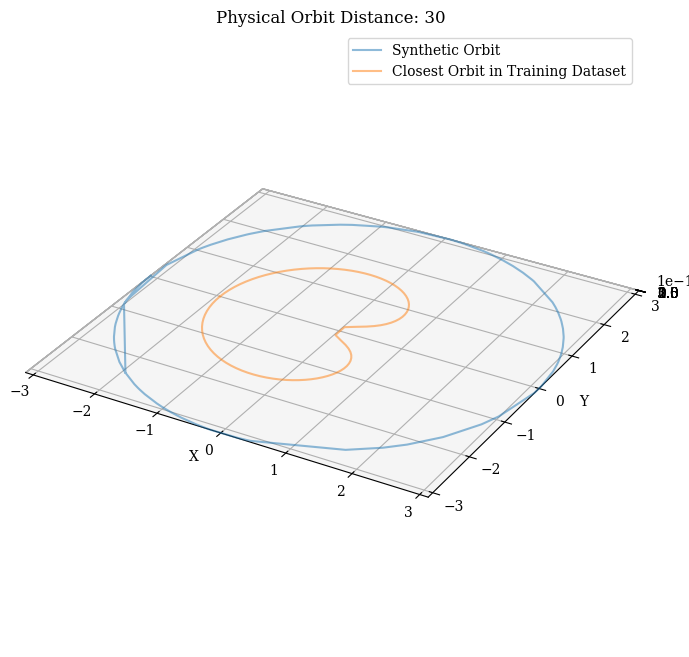

In [45]:
specific_orbits = visualize_orbit_and_closest_by_distance(refined_orbits_df, 'nearest_orbit_distance', 30, 5, 'experiment_id', experiments_folder, data)

### Feature

1

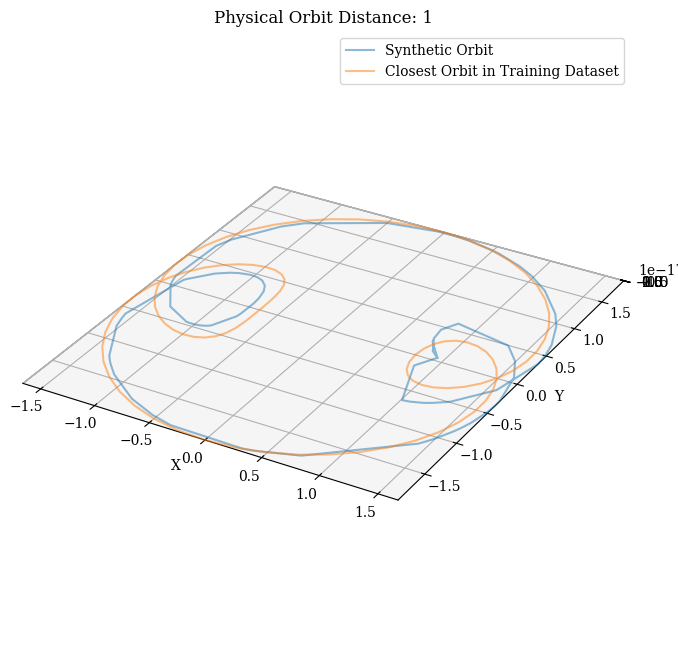

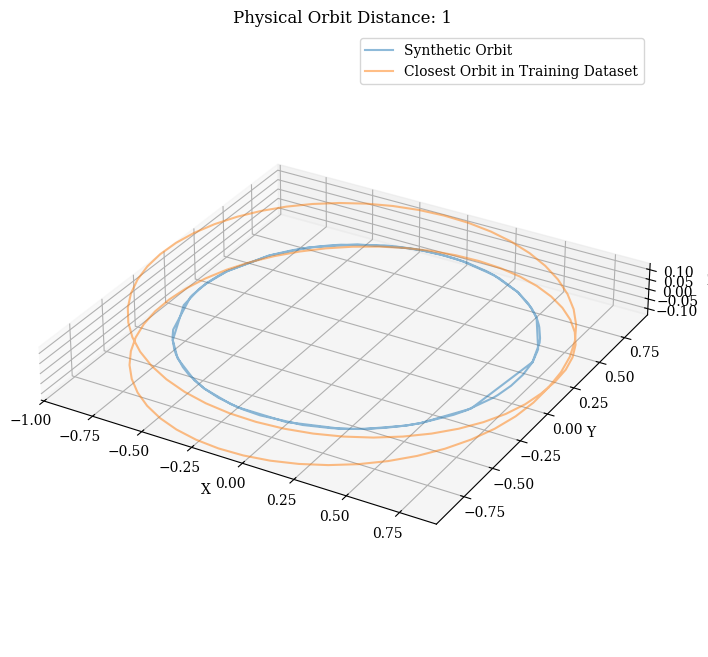

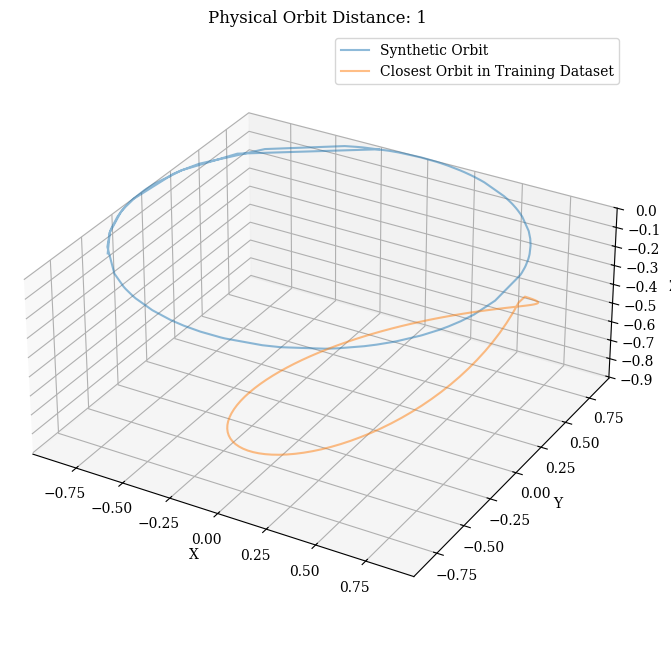

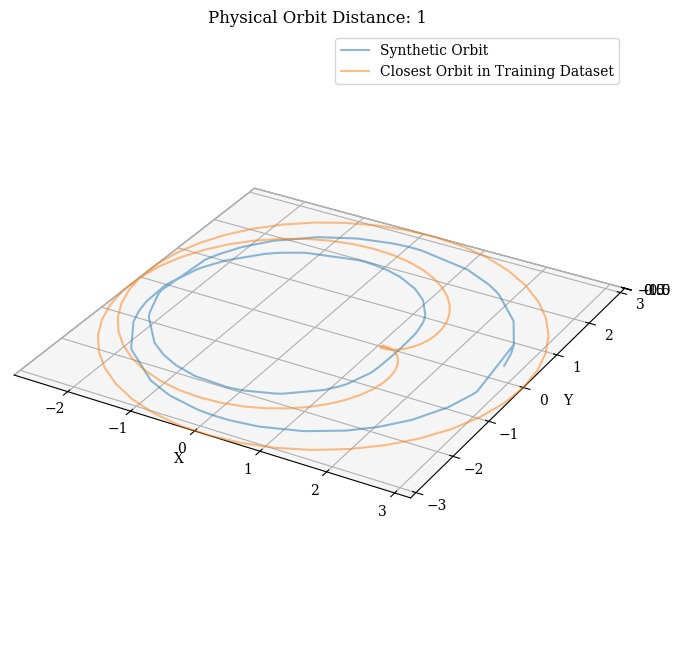

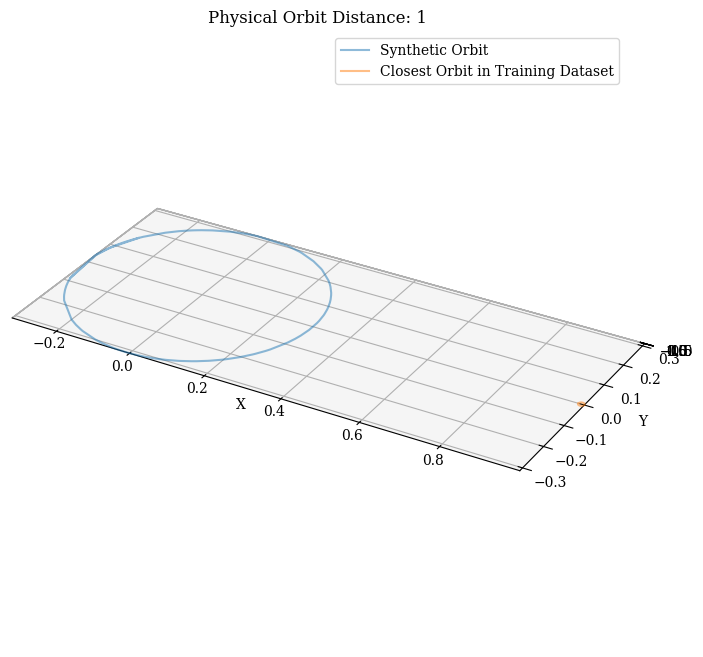

In [46]:
specific_orbits = visualize_orbit_and_closest_by_distance(refined_orbits_df, 'feature_distance_from_closest_orbit', 1, 5, 'experiment_id', experiments_folder, data)

10

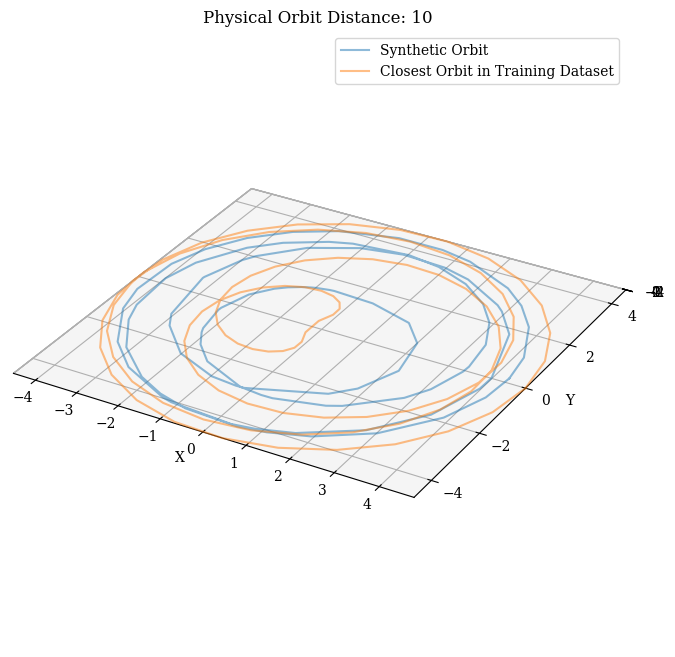

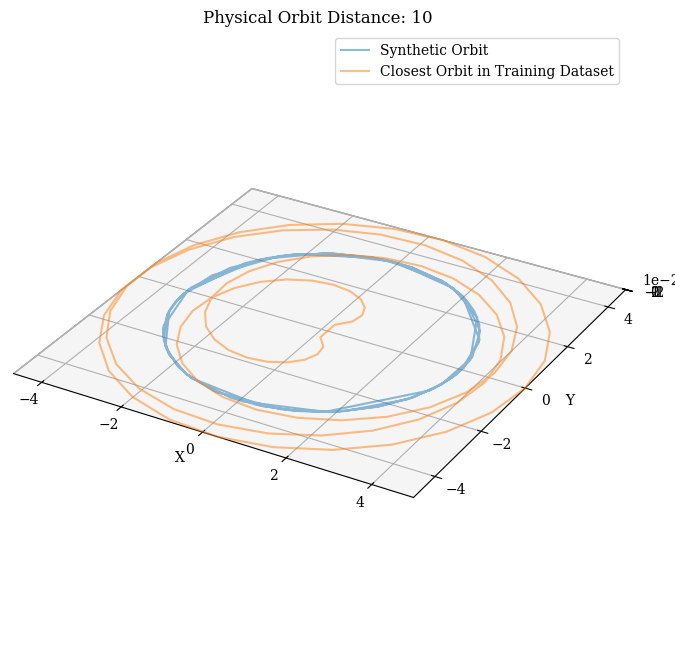

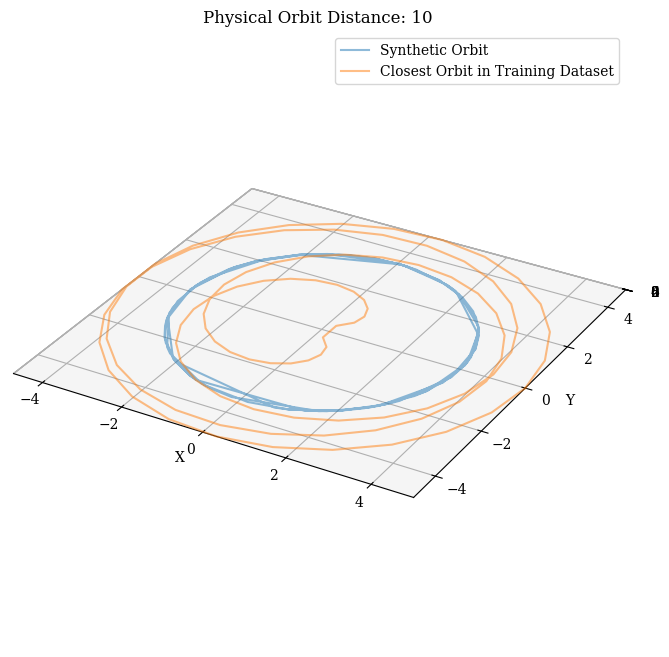

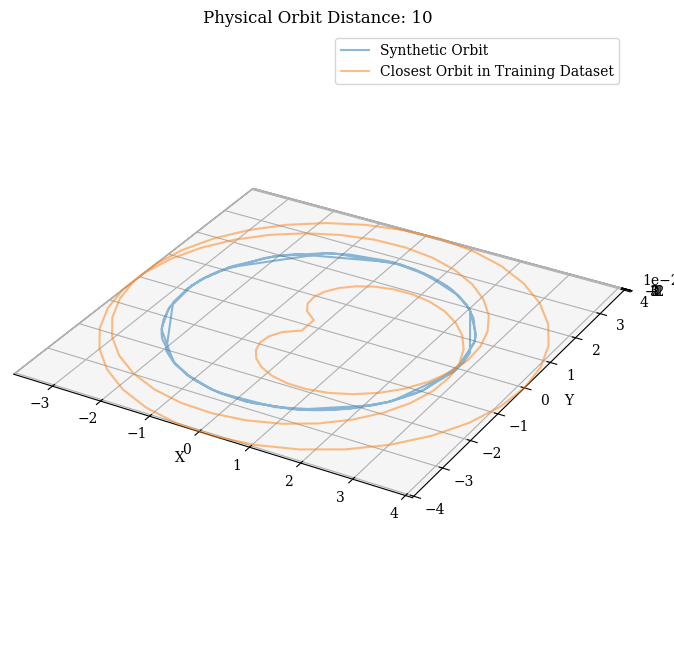

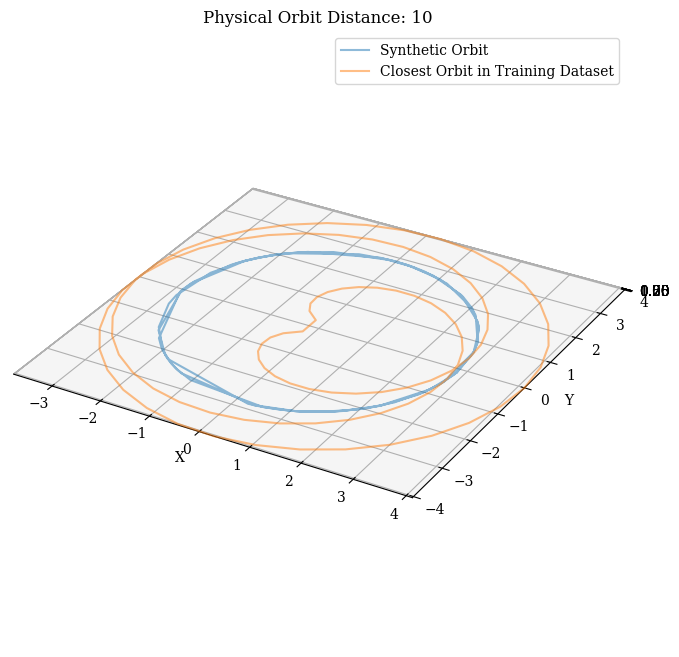

In [47]:
specific_orbits = visualize_orbit_and_closest_by_distance(refined_orbits_df, 'feature_distance_from_closest_orbit', 10, 5, 'experiment_id', experiments_folder, data)

20

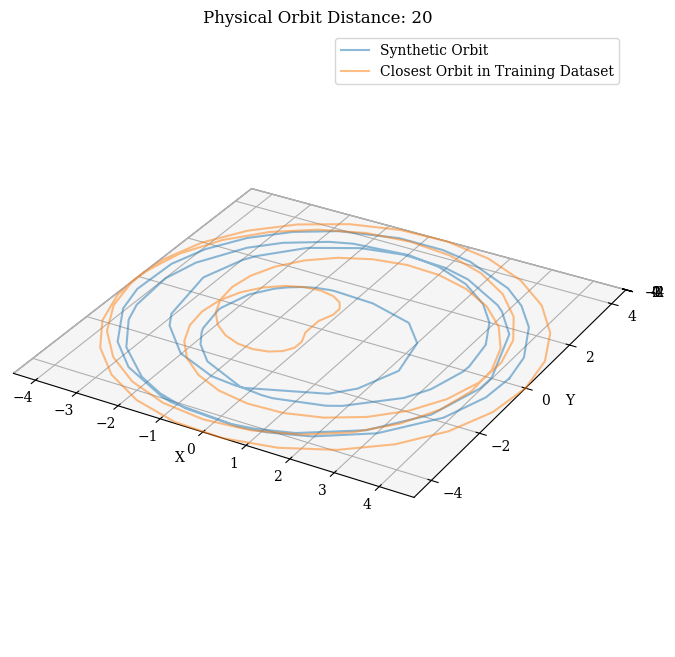

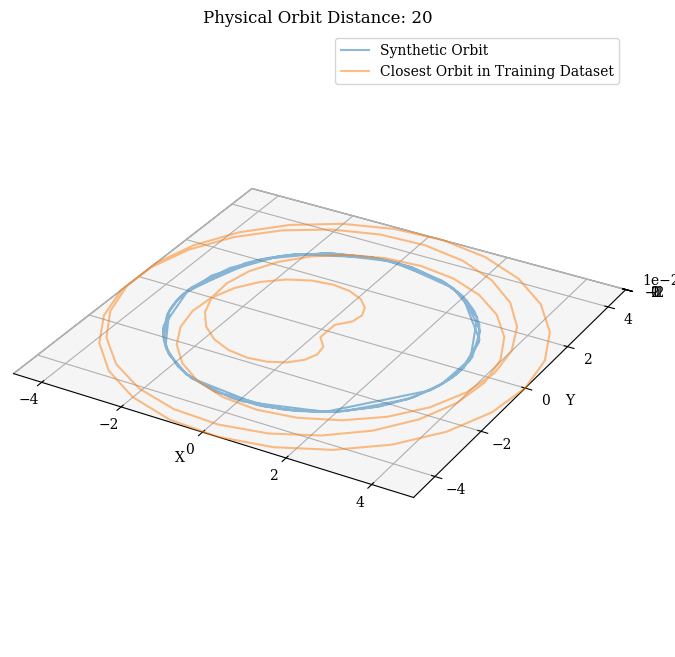

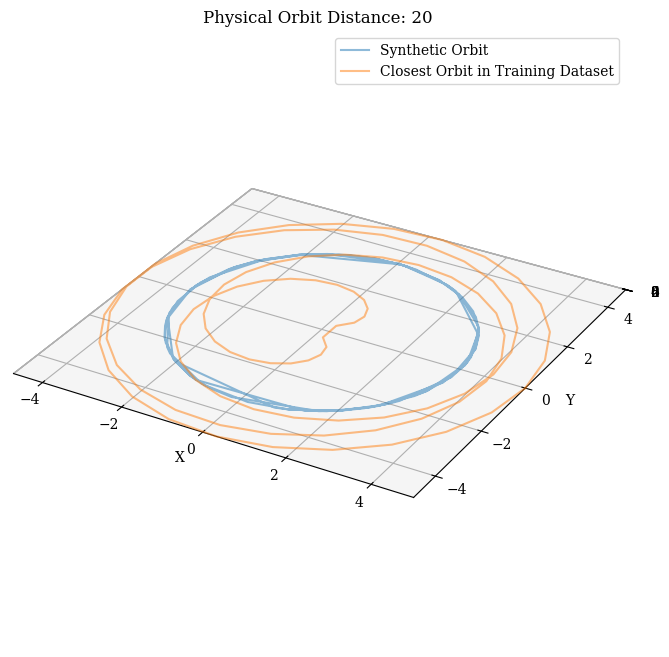

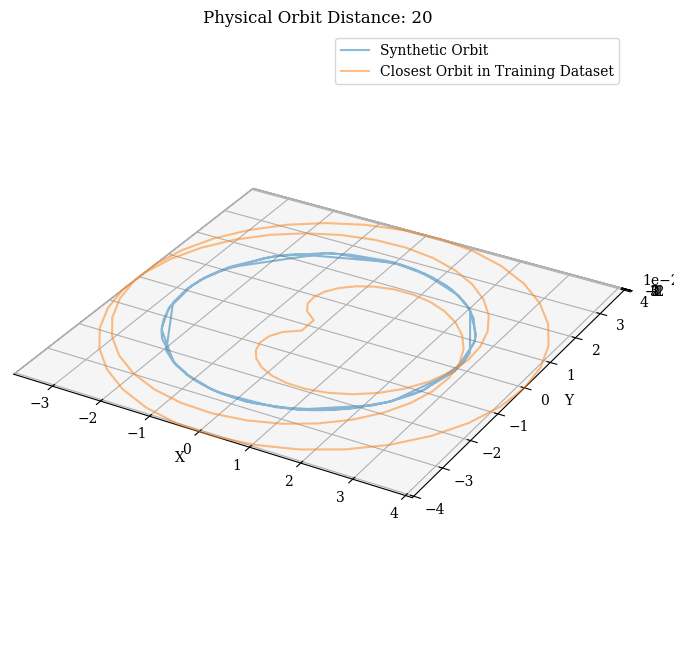

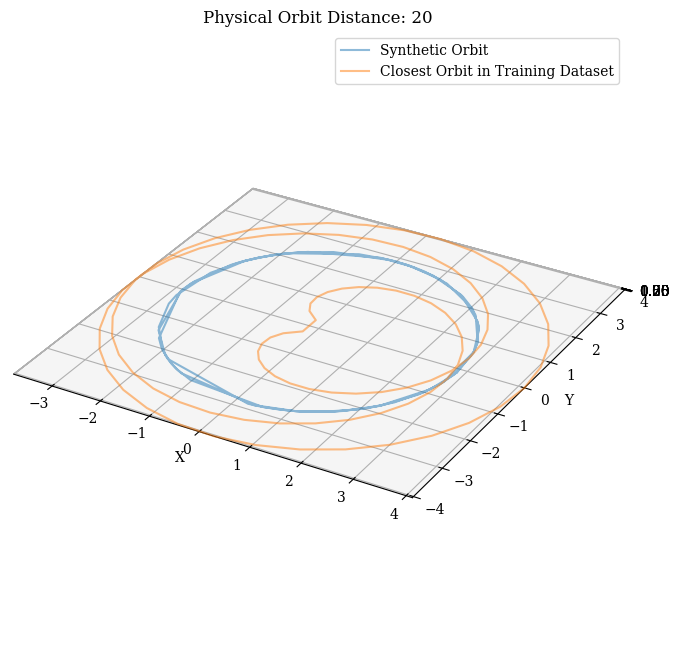

In [48]:
specific_orbits = visualize_orbit_and_closest_by_distance(refined_orbits_df, 'feature_distance_from_closest_orbit', 20, 5, 'experiment_id', experiments_folder, data)

## Random Orbits

In [49]:
def visualize_orbit_and_closest_by_distance(df, column, value, n, experiment_id_column, orbits_folder, orbit_dataset):
    specific_orbits = []
    df.reset_index(drop=True, inplace=True)
    closest_rows = find_closest_rows(df, column, value, n)
    closest_indexes = df.loc[closest_rows].index.tolist()
    positions, experiment_ids = filter_and_find_position(df, closest_indexes, experiment_id_column)
    nearest_orbits = df.loc[closest_rows]['nearest_orbit'].tolist()
    
    for pos, exp_id, nearest_orbit in zip(positions, experiment_ids, nearest_orbits):
        orbits = np.load(f'{orbits_folder}/experiment_{exp_id}/exp{exp_id}_refined_orbits.npy')
        specific_orbit = orbits[pos:pos+1]
        specific_orbit, _, _ = reorder_orbits(specific_orbit)
        nearest_orbit_data = orbit_dataset[nearest_orbit:nearest_orbit+1]
        combined_orbits = np.vstack([specific_orbit, nearest_orbit_data])
        specific_orbits.append(combined_orbits)
    
    for orbits in specific_orbits:
        visualize_static_orbits(orbits[:,1:,:], orbit_names=['Synthetic Orbit', 'Closest Orbit in Training Dataset'],title=f'Physical Orbit Distance: {value}', equal_aspect=True)

    return specific_orbits

In [50]:
def visualize_random_orbits(df, n, experiment_id_column, orbits_folder, orbit_dataset, dataset_df, random_seed=420, plot_feature_closest=True, equal_aspect=True):
    if random_seed is not None:
        random.seed(random_seed)
    
    specific_orbits = []
    df.reset_index(drop=True, inplace=True)
    
    # Randomly select n orbits
    random_indexes = random.sample(range(len(df)), n)
    sampled_df = df.loc[random_indexes]
    
    # Extract nearest_orbit, nearest_orbit_distance, feature_closest_orbit, and feature_distance_from_closest_orbit
    nearest_orbits = sampled_df['nearest_orbit'].tolist()
    nearest_orbit_distances = sampled_df['nearest_orbit_distance'].tolist()
    feature_closest_orbits = sampled_df['feature_closest_orbit'].tolist()
    feature_distances = sampled_df['feature_distance_from_closest_orbit'].tolist()
    
    positions, experiment_ids = filter_and_find_position(df, random_indexes, experiment_id_column)
    
    for pos, exp_id, nearest_orbit, distance, feature_orbit, feature_distance in zip(positions, experiment_ids, nearest_orbits, nearest_orbit_distances, feature_closest_orbits, feature_distances):
        orbits = np.load(f'{orbits_folder}/experiment_{exp_id}/exp{exp_id}_refined_orbits.npy')
        specific_orbit = orbits[pos:pos+1]
        specific_orbit, _, _ = reorder_orbits(specific_orbit)
        nearest_orbit_data = orbit_dataset[nearest_orbit:nearest_orbit+1]
        combined_orbits = np.vstack([specific_orbit, nearest_orbit_data])
        
        if plot_feature_closest:
            feature_orbit_data = orbit_dataset[feature_orbit:feature_orbit+1]
            combined_orbits = np.vstack([combined_orbits, feature_orbit_data])

        specific_orbits.append(combined_orbits)
        
        # Visualize with the provided distances
        orbit_names = ['Synthetic Orbit', 'Spatial Closest Orbit in Dataset']
        if plot_feature_closest:
            orbit_names.append('Feature Closest Orbit in Dataset')
        
        visualize_static_orbits(
            combined_orbits[:,1:,:], 
            orbit_names=orbit_names, 
            title=f'Physical Distance: {round(distance, 2)}, Feature Distance: {round(feature_distance, 2)}', 
            equal_aspect=equal_aspect
        )

    return specific_orbits

In [51]:
def visualize_random_orbits(df, n, experiment_id_column, orbits_folder, orbit_dataset, dataset_df, random_seed=420, plot_feature_closest=True, equal_aspect=True):
    if random_seed is not None:
        random.seed(random_seed)
    
    specific_orbits = []
    df.reset_index(drop=True, inplace=True)
    
    # Randomly select n orbits
    random_indexes = random.sample(range(len(df)), n)
    sampled_df = df.loc[random_indexes]
    
    # Extract nearest_orbit, nearest_orbit_distance, feature_closest_orbit, and feature_distance_from_closest_orbit
    nearest_orbits = sampled_df['nearest_orbit'].tolist()
    nearest_orbit_distances = sampled_df['nearest_orbit_distance'].tolist()
    feature_closest_orbits = sampled_df['feature_closest_orbit'].tolist()
    feature_distances = sampled_df['feature_distance_from_closest_orbit'].tolist()
    
    # Extract synthetic energies and periods before the loop
    synthetic_energies = sampled_df['calculated_jacobi'].tolist()
    synthetic_periods = sampled_df['period'].tolist()
    
    positions, experiment_ids = filter_and_find_position(df, random_indexes, experiment_id_column)
    
    for i, (pos, exp_id, nearest_orbit, distance, feature_orbit, feature_distance) in enumerate(zip(positions, experiment_ids, nearest_orbits, nearest_orbit_distances, feature_closest_orbits, feature_distances)):
        orbits = np.load(f'{orbits_folder}/experiment_{exp_id}/exp{exp_id}_refined_orbits.npy')
        specific_orbit = orbits[pos:pos+1]
        specific_orbit, _, _ = reorder_orbits(specific_orbit)
        nearest_orbit_data = orbit_dataset[nearest_orbit:nearest_orbit+1]
        combined_orbits = np.vstack([specific_orbit, nearest_orbit_data])
        
        # Extract energy and period for feature closest orbits
        feature_energy = dataset_df.loc[feature_orbit, 'calculated_jacobi']
        feature_period = dataset_df.loc[feature_orbit, 'period']
        
        # Calculate absolute differences
        energy_diff = abs(synthetic_energies[i] - feature_energy)
        period_diff = abs(synthetic_periods[i] - feature_period)
        
        if plot_feature_closest:
            feature_orbit_data = orbit_dataset[feature_orbit:feature_orbit+1]
            combined_orbits = np.vstack([combined_orbits, feature_orbit_data])

        specific_orbits.append(combined_orbits)
        
        # Visualize with the provided distances and differences in scientific notation
        orbit_names = ['Synthetic Orbit', 'Spatial Closest Orbit in Dataset']
        if plot_feature_closest:
            orbit_names.append('Feature Closest Orbit in Dataset')
        
        visualize_static_orbits(
            combined_orbits[:,1:,:], 
            orbit_names=orbit_names, 
            title=f'd) Physical Distance: {distance:.2f}, Energy Diff: {energy_diff:.1e}, Period Diff: {period_diff:.1e}', 
            equal_aspect=equal_aspect
        )

    return specific_orbits

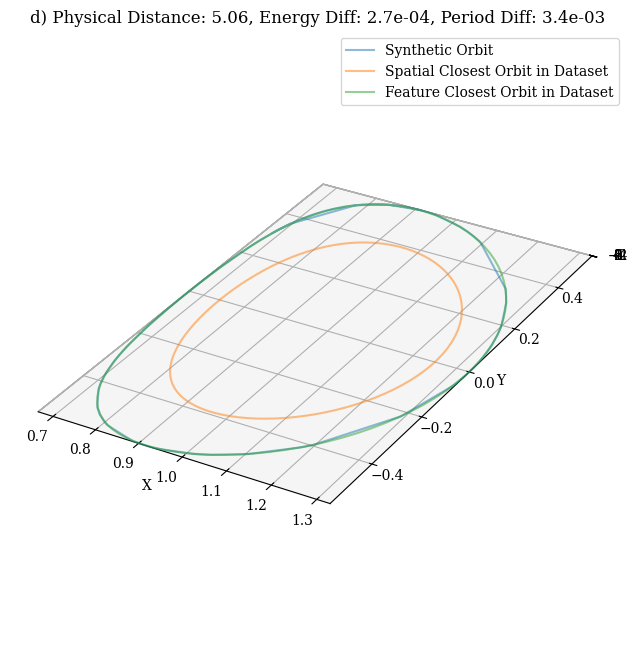

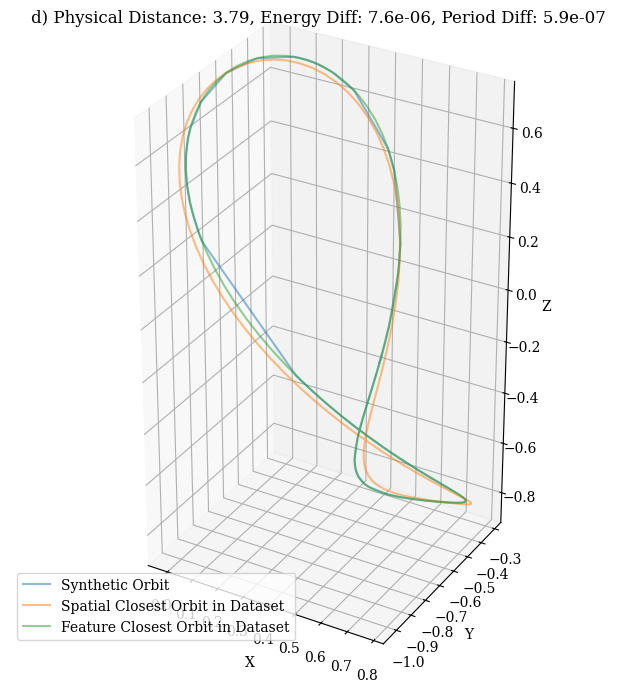

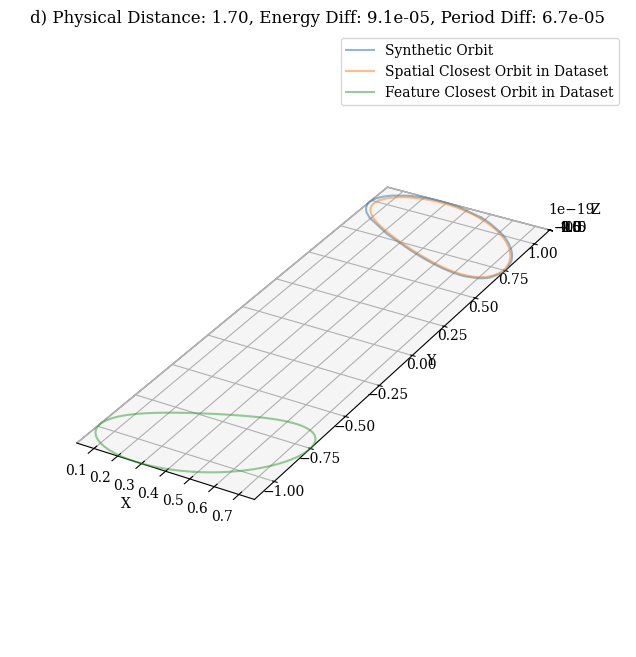

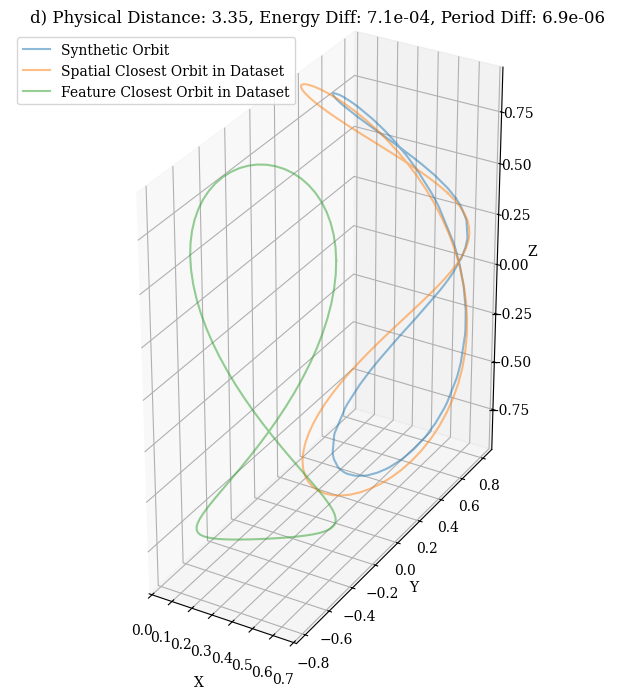

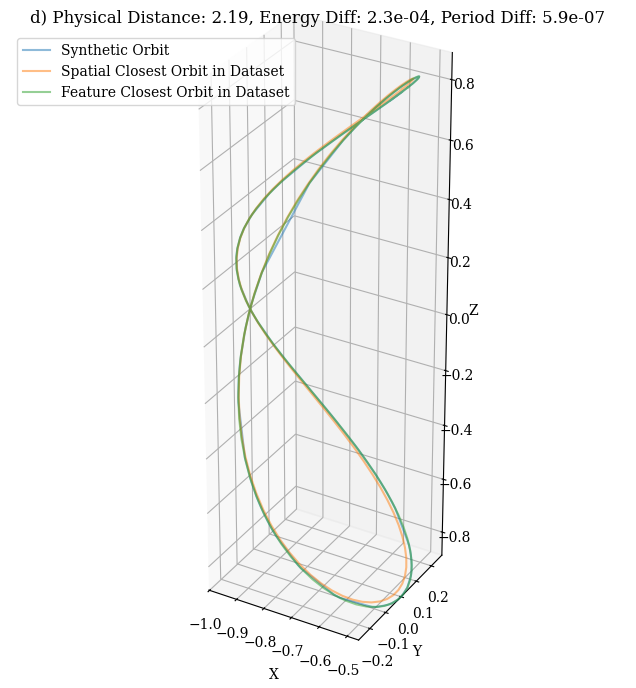

...

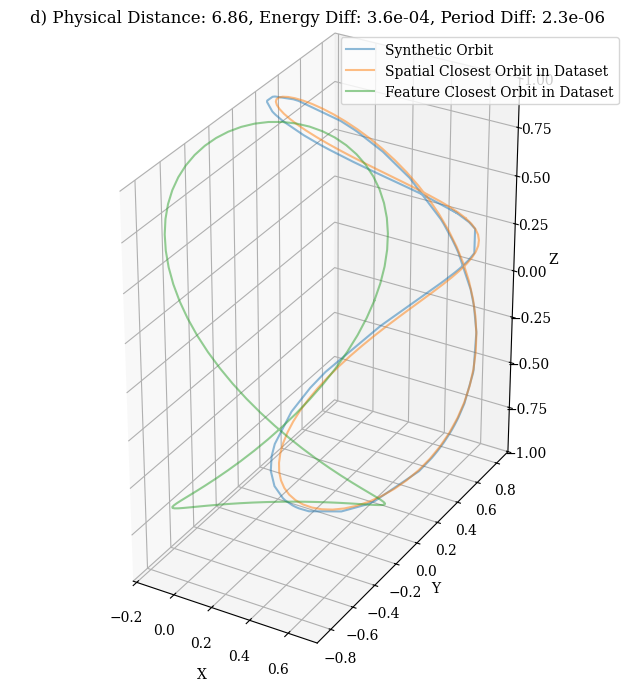

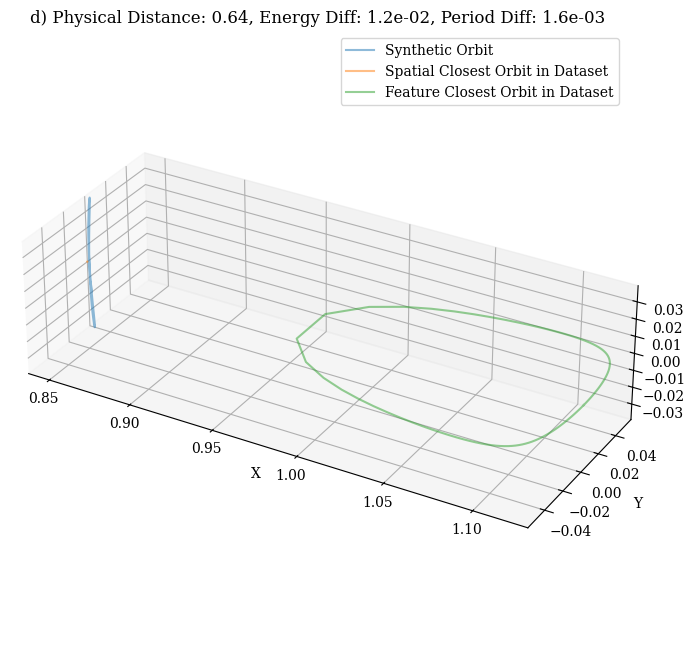

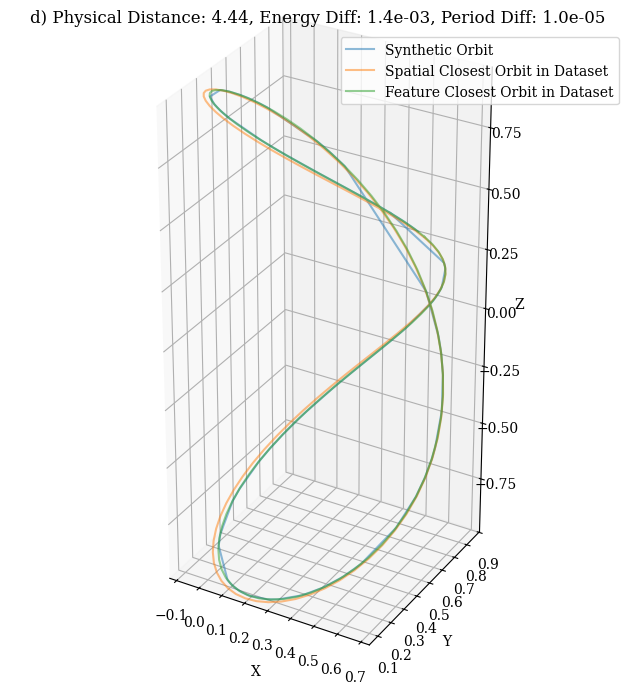

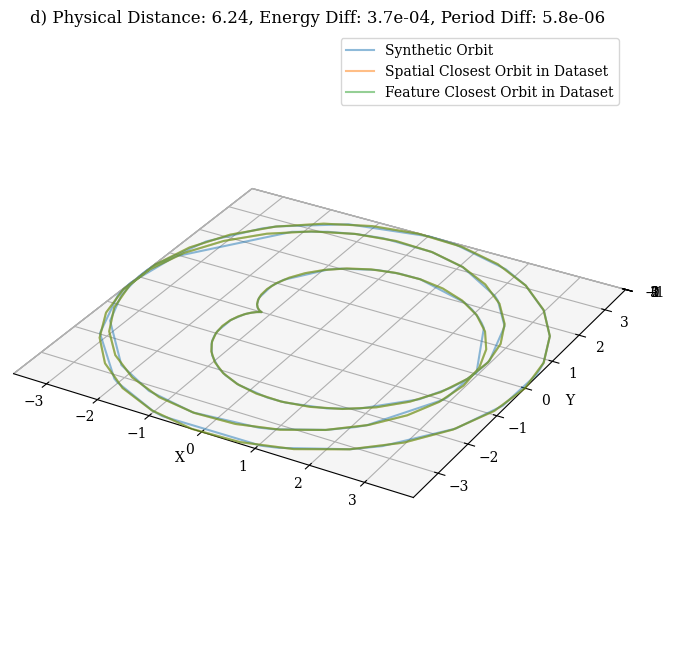

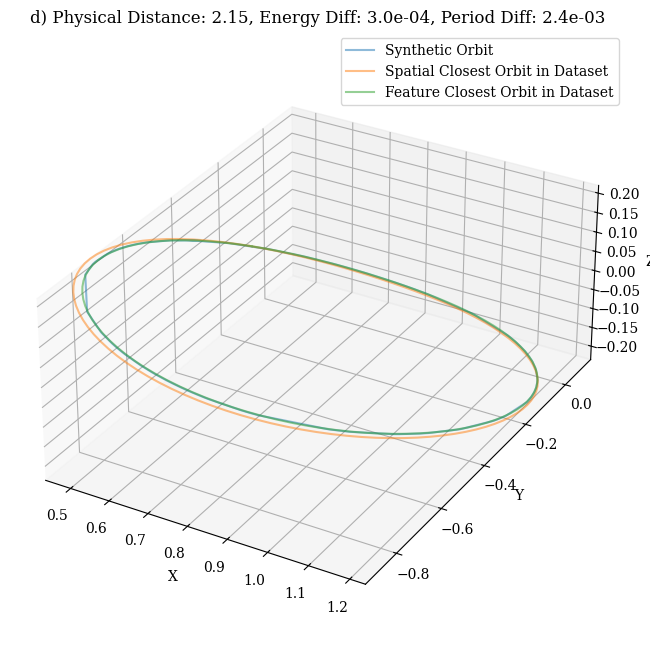

In [52]:
orb = visualize_random_orbits(refined_orbits_df, 100, 'experiment_id', experiments_folder, data, orbit_df, plot_feature_closest=True)